# Import libraries

In [1]:
import os
import pandas as pd
import numpy as np
from IPython.core.display import display, HTML
import pymongo
from pymongo import MongoClient
import folium
import json
from shapely.geometry import Point
from shapely.geometry.polygon import Polygon
import geopandas as gpd
from matplotlib import pyplot as plt
import time
import datetime
from datetime import datetime
from datetime import timedelta  
from selenium import webdriver
from scipy import special, optimize
from IPython.display import Math
import math
from bokeh.plotting import figure, output_notebook, show
from bokeh.models import ColumnDataSource, ColorBar
from bokeh.palettes import Spectral6
from bokeh.transform import linear_cmap
import bokeh.plotting as bpl
import bokeh.models as bmo
from bokeh.palettes import d3
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
from bokeh.io import export_png
from math import isnan

print("Pymongo version: " + pymongo.__version__)

Pymongo version: 3.7.2


# Metadata

## Load data
### Base data

In [2]:
client = MongoClient('localhost', 27017)
db = client.Belair
collection = db.data
# Extract data, sort by timestamp and reset indexes
base_df = pd.DataFrame(list(collection.find())).reset_index(drop=True)
print(len(base_df))
base_df.head()

193008


,_id,device,gateways,gpsLat,gpsLon,hdop,rx_time,seqNumber,spfact
0,5c17af0d4fa20f164de4b0bb,3432333852378918,"[{'rssi': -93, 'esp': -93.461838, 'snr': 10, '...",51.194618,4.418419,0.66,2018-12-17 14:13:33.410,54916,7
1,5c17af2d4fa20f164de4b0c7,3432333852378918,"[{'rssi': -104, 'esp': -104.331955, 'snr': 11,...",51.194618,4.418417,0.69,2018-12-17 14:14:04.616,54917,7
2,5c17af424fa20f164de4b0cf,3432333864377C18,"[{'rssi': -110, 'esp': -111.764351, 'snr': 3, ...",51.215313,4.408513,1.02,2018-12-17 14:14:26.937,8823,8
3,5c17af4d4fa20f164de4b0d4,3432333852378918,"[{'rssi': -107, 'esp': -107.973228, 'snr': 6, ...",51.194614,4.418419,0.74,2018-12-17 14:14:36.499,54918,7
4,5c17af604fa20f164de4b0df,3432333851378918,"[{'rssi': -114, 'esp': -119.455406, 'snr': -4,...",51.241817,4.430120,0.66,2018-12-17 14:14:56.056,48522,7


In [3]:
df = base_df.drop(columns=['_id', 'gateways', 'hdop']).sort_values('rx_time')
df.head()

,device,gpsLat,gpsLon,rx_time,seqNumber,spfact
0,3432333852378918,51.194618,4.418419,2018-12-17 14:13:33.410,54916,7
37000,3432333855378A18,51.215122,4.413489,2018-12-17 14:13:47.826,15652,7
1,3432333852378918,51.194618,4.418417,2018-12-17 14:14:04.616,54917,7
37001,3432333855378A18,51.215408,4.413910,2018-12-17 14:14:19.768,15653,7
2,3432333864377C18,51.215313,4.408513,2018-12-17 14:14:26.937,8823,8


### Extra data

In [4]:
# working_days = pd.read_excel (r'C:\Users\JeffG\Documents\Thesis\bpost_working_days.xlsx')
working_days = pd.read_excel(r'D:\Documents\Thesis\Case 2 - data\data\bpost_working_days.xlsx')
working_days['date'] = pd.to_datetime(working_days['date'])
print(working_days.dtypes)
working_days.head()

FileNotFoundError: [Errno 2] No such file or directory: 'C:\\Users\\JeffG\\Documents\\Thesis\\bpost_working_days.xlsx'

## Data extension

In [5]:
def extend_df(df):
    # Sort
    #df2 = df.sort_values(['device','rx_time'],ascending=[False,True]).reset_index()    
    df2 = df.sort_values(['device'],ascending=[False]).reset_index()
    df2 = df2.sort_values(['rx_time'],ascending=[True]).reset_index()
    
    # Add day-of-the-week columns
    df2['day_of_week'] = df2['rx_time'].dt.day_name()
    
    # Add separate time and date columns
    df2['time'] = df2['rx_time'].dt.time
    df2['date'] = df2['rx_time'].dt.date
    df2['date'] = pd.to_datetime(df2['date'])
    
    # Calculate time differences based on the device IDs 
    IPT = df2.groupby('device')['rx_time'].diff()
    
    # Check if the SPF changed
    same_spfact = df2.groupby('device')['spfact'].apply(lambda x : x==x.shift())
    
    # Check how much the SPF changed
    spfact_diff = df2.groupby('device')['spfact'].apply(lambda x : x-x.shift())
    
    # Add column with SPF of previous packet
    prev_spfact = df2.groupby('device')['spfact'].shift()
    
    # Add the new columns to the previous data frame
    df2 = df2.assign(IPT=pd.Series(IPT.values))
    df2['IPT'] = df2['IPT'].astype('timedelta64[s]')
    df2 = df2.assign(same_spfact=pd.Series(same_spfact.values))
    df2 = df2.assign(spfact_diff=pd.Series(spfact_diff.values))
    df2 = df2.assign(prev_spfact=pd.Series(prev_spfact.values))
    # Drop the rows with NaT-value
    df2 = df2.dropna(subset=['IPT'])
    df2 = df2.drop(columns=['index', 'level_0'], axis=1)
    
    return df2

In [6]:
# Extend with new features
df_ = extend_df(df)
# Merge with working days table
# df_ = pd.merge(df_, working_days, on='date')
df_.head()

,device,gpsLat,gpsLon,rx_time,seqNumber,spfact,day_of_week,time,date,IPT,same_spfact,spfact_diff,prev_spfact
2,3432333852378918,51.194618,4.418417,2018-12-17 14:14:04.616,54917,7,Monday,14:14:04.616000,2018-12-17,31.0,True,0.0,7.0
3,3432333855378A18,51.215408,4.413910,2018-12-17 14:14:19.768,15653,7,Monday,14:14:19.768000,2018-12-17,31.0,True,0.0,7.0
5,3432333852378918,51.194614,4.418419,2018-12-17 14:14:36.499,54918,7,Monday,14:14:36.499000,2018-12-17,31.0,True,0.0,7.0
6,3432333855378A18,51.215408,4.413912,2018-12-17 14:14:51.045,15654,7,Monday,14:14:51.045000,2018-12-17,31.0,True,0.0,7.0
8,3432333852378918,51.194611,4.418422,2018-12-17 14:15:07.931,54919,7,Monday,14:15:07.931000,2018-12-17,31.0,True,0.0,7.0


## Data visualization

### IPT vs time (per device)

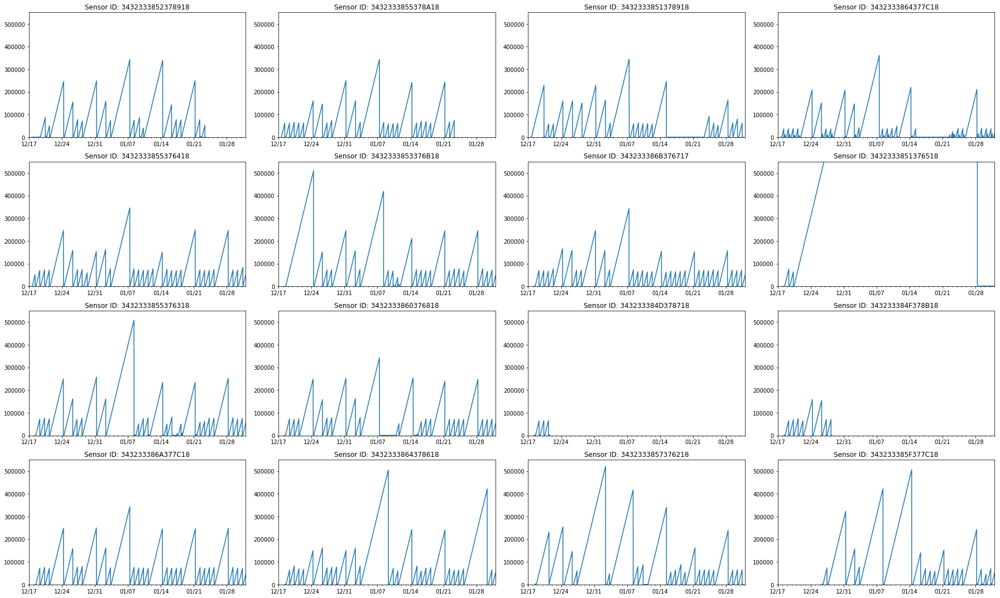

In [7]:
import datetime
import matplotlib.dates as mdates
categories = df_['device'].unique()
# z = working_days[(working_days['working day'] == 1)]
fig = plt.figure(figsize=(25,15))

mondays = mdates.WeekdayLocator(mdates.MONDAY)        # major ticks on the mondays
alldays = mdates.DayLocator()
weeksFmt = mdates.DateFormatter('%m/%d')

for c,num in zip(categories, range(1,len(categories)+1)):
    df0=df_[df_['device']==c]
    ax = fig.add_subplot(4, 4, num)
    ax.plot(df0['rx_time'], df0[['IPT']])
    ax.set_title("Sensor ID: " + str(c))
    ax.set_xlim([datetime.date(2018, 12, 17), datetime.date(2019, 2, 1)])
    ax.set_ylim(0,550000)

    ax.xaxis.set_major_locator(mondays)
    ax.xaxis.set_minor_locator(alldays)
    ax.xaxis.set_major_formatter(weeksFmt)
    
    # Plot working days
    #for xc in z.date.values:
    #    plt.axvline(x=xc, color='r', linestyle='-')

plt.tight_layout()
# plt.savefig(r'C:\Users\JeffG\Dropbox\ICT-Elektronica\Thesis\scripts\Case 2 - Bel-Air\Results' + '/metadata_IPT_time.png')
plt.show()

In [8]:
device_ids = base_df['device'].unique()

# Real data

In [9]:
metricsList = ['airquality.no2', 'airquality.o3', 'airquality.pm1', 'airquality.pm10', 
               'airquality.pm25', 'environment.relativehumidity', 'environment.temperature']
sizes = pd.DataFrame(columns=metricsList, index=device_ids)
for thingID in device_ids:
    path = r'D:\Documents\Thesis\Case 2 - data\data/lora.' + thingID
    df_1 = df[df['device']== thingID]
    occ = len(df_1)
    first_timestamp = df_1.iloc[0].rx_time; #print(first_timestamp)
    last_timestamp = df_1.iloc[-1].rx_time; #print(last_timestamp)
    for metricID in metricsList:
        df_2 = pd.read_csv(path+'\\lora.'+str(thingID) +'_' + str(metricID) +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
        df_2['time'] = pd.to_datetime(df_2['time'], unit='ms')
        #Filter out data points that are outside the boundaries of the metadata
        df_2 = df_2[(df_2['time']>first_timestamp) & (df_2['time']<last_timestamp)]
        sizes.loc[thingID][metricID] = len(df_2)
sizes

,airquality.no2,airquality.o3,airquality.pm1,airquality.pm10,airquality.pm25,environment.relativehumidity,environment.temperature
3432333852378918,89455,89455,89084,89454,89455,89455,89455
3432333864377C18,103279,103279,100601,103275,103279,103279,103279
3432333851378918,107660,107660,106529,107657,107660,107660,107660
3432333855378A18,76655,76655,52630,76617,76655,76655,76655
3432333855376418,102541,102541,96265,102526,102541,102541,102541
343233386B376717,89277,89277,68135,89235,89277,89277,89277
343233386A377C18,106550,106550,105474,106549,106550,106550,106550
3432333853376B18,93904,93904,93659,93904,93904,93904,93904
343233384F378B18,20033,20033,10795,20012,20033,20033,20033
3432333860376818,98315,98315,98165,98315,98315,98315,98315


## Compare size of real data to metadata

In [10]:
thingID = '343233384D378718'
df_1 = df[df['device']== thingID]
occ = len(df_1)
first_timestamp = df_1.iloc[0].rx_time; print(first_timestamp)
last_timestamp = df_1.iloc[-1].rx_time; print(last_timestamp)
print(len(df_1))
df_1.head()
# df_1.to_csv(r'C:\Users\JeffG\Dropbox\ICT-Elektronica\Thesis\scripts\Case 2 - Bel-Air\Results\test.csv')

2018-12-18 07:43:32.598000
2018-12-21 12:58:40.263000
801


,device,gpsLat,gpsLon,rx_time,seqNumber,spfact
40144,343233384D378718,51.234936,4.409110,2018-12-18 07:43:32.598,47703,12
38894,343233384D378718,51.231384,4.409116,2018-12-18 07:45:12.602,47704,12
40237,343233384D378718,51.230957,4.411328,2018-12-18 07:47:55.514,47705,11
38924,343233384D378718,51.230930,4.412442,2018-12-18 07:49:36.925,47706,11
40255,343233384D378718,51.228771,4.413527,2018-12-18 07:50:24.230,47707,11


In [11]:
# Load real data
# path = r'C:\Users\JeffG\Desktop\Case 2 - data\data/lora.' + thingID
path = r'D:\Documents\Thesis\Case 2 - data\data/lora.' + thingID
df_2 = pd.read_csv(path+'\\lora.'+str(thingID) +'_' + 'airquality.no2' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
df_2['time'] = pd.to_datetime(df_2['time'], unit='ms')
df_2 = df_2[(df_2['time']>first_timestamp) & (df_2['time']<last_timestamp)]
df_2.head()

,time,value
2338,2018-12-18 07:45:12.602,64.374520
2339,2018-12-18 07:47:55.514,70.005646
2340,2018-12-18 07:49:36.925,79.536934
2341,2018-12-18 07:50:24.230,80.259995
2342,2018-12-18 07:52:04.631,87.819290


In [12]:
result = pd.DataFrame(columns=['Device ID', 'Data points in metadata', 'Data points in real data', 'Ratio[%]'])
for thingID in device_ids:
    # Check number of occurrences of this device in the basic database (metadata)
    df_1 = df[df['device']== thingID]
    first_timestamp = df_1.iloc[0].rx_time
    last_timestamp = df_1.iloc[-1].rx_time
    nr_meta = len(df_1)
    # Load real data
#     path = r'C:\Users\JeffG\Desktop\Case 2 - data\data/lora.' + thingID
    path = r'D:\Documents\Thesis\Case 2 - data\data/lora.' + thingID
    df_2 = pd.read_csv(path+'\\lora.'+str(thingID) +'_' + 'airquality.no2' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
    df_2['time'] = pd.to_datetime(df_2['time'], unit='ms')
    #Filter out data points that are outside the boundaries of the metadata
    df_2 = df_2[(df_2['time']>first_timestamp) & (df_2['time']<last_timestamp)]
    nr_real = len(df_2)
    
    result = result.append({"Device ID": thingID, 
                            "Data points in metadata": nr_meta, 
                            "Data points in real data": nr_real,
                            "Ratio[%]": round(nr_meta/nr_real*100,2)}, ignore_index=True)

In [13]:
print(result.to_latex())

\begin{tabular}{llllr}
\toprule
{} &         Device ID & Data points in metadata & Data points in real data &  Ratio[\%] \\
\midrule
0  &  3432333852378918 &                   12280 &                    89455 &     13.73 \\
1  &  3432333864377C18 &                   38978 &                   103279 &     37.74 \\
2  &  3432333851378918 &                   33145 &                   107660 &     30.79 \\
3  &  3432333855378A18 &                   10159 &                    76655 &     13.25 \\
4  &  3432333855376418 &                    9784 &                   102541 &      9.54 \\
5  &  343233386B376717 &                    7062 &                    89277 &      7.91 \\
6  &  343233386A377C18 &                    9318 &                   106550 &      8.75 \\
7  &  3432333853376B18 &                   11663 &                    93904 &     12.42 \\
8  &  343233384F378B18 &                    2277 &                    20033 &     11.37 \\
9  &  3432333860376818 &                   20387

## Check number of values for each metric

## Check timestamps
If most of the timestamps are matching, we can assume that the other timestamps can easily be integrated

In [14]:
result = pd.DataFrame(columns=['Device ID', 'Occurrences in metadata', 'Matches', 'Difference', 'Difference[%]'])
for thingID in device_ids:
    # Check number of occurrences of this device in the basic database
    df_1 = df[df['device']== thingID]
    occ = len(df_1)
#     path = r'C:\Users\JeffG\Desktop\Case 2 - data\data/lora.' + thingID
    path = r'D:\Documents\Thesis\Case 2 - data\data/lora.' + thingID
    df_2 = pd.read_csv(path+'\\lora.'+str(thingID) +'_' + 'airquality.no2' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
    df_2['time'] = pd.to_datetime(df_2['time'], unit='ms')
    df_3 = df_1.merge(df_2, left_on='rx_time', right_on='time', how='inner')
    matches = len(df_3)
#     row = pd.DataFrame(, ignore_index=True)
    result = result.append({"Device ID": thingID, "Occurrences in metadata": occ, "Matches": matches, 
                        "Difference": (occ - matches),"Difference[%]": ((occ-matches)/matches*100)}, ignore_index=True)
    print(thingID + " | occurrences: " + str(occ) + 
          "\t - \tmatches: " + str(matches) + 
          "\t - \tdiff: " + str(occ - matches) + "  \t({:.2f}%)".format((occ-matches)/matches*100))

3432333852378918 | occurrences: 12280	 - 	matches: 12275	 - 	diff: 5  	(0.04%)
3432333864377C18 | occurrences: 38978	 - 	matches: 37695	 - 	diff: 1283  	(3.40%)
3432333851378918 | occurrences: 33145	 - 	matches: 32250	 - 	diff: 895  	(2.78%)
3432333855378A18 | occurrences: 10159	 - 	matches: 10159	 - 	diff: 0  	(0.00%)
3432333855376418 | occurrences: 9784	 - 	matches: 9325	 - 	diff: 459  	(4.92%)
343233386B376717 | occurrences: 7062	 - 	matches: 6574	 - 	diff: 488  	(7.42%)
343233386A377C18 | occurrences: 9318	 - 	matches: 8417	 - 	diff: 901  	(10.70%)
3432333853376B18 | occurrences: 11663	 - 	matches: 10748	 - 	diff: 915  	(8.51%)
343233384F378B18 | occurrences: 2277	 - 	matches: 2277	 - 	diff: 0  	(0.00%)
3432333860376818 | occurrences: 20387	 - 	matches: 19397	 - 	diff: 990  	(5.10%)
343233384D378718 | occurrences: 801	 - 	matches: 801	 - 	diff: 0  	(0.00%)
3432333855376318 | occurrences: 9198	 - 	matches: 8734	 - 	diff: 464  	(5.31%)
3432333851376518 | occurrences: 2211	 - 	matches

In [15]:
print(result.to_latex())

\begin{tabular}{lllllr}
\toprule
{} &         Device ID & Occurrences in metadata & Matches & Difference &  Difference[\%] \\
\midrule
0  &  3432333852378918 &                   12280 &   12275 &          5 &       0.040733 \\
1  &  3432333864377C18 &                   38978 &   37695 &       1283 &       3.403634 \\
2  &  3432333851378918 &                   33145 &   32250 &        895 &       2.775194 \\
3  &  3432333855378A18 &                   10159 &   10159 &          0 &       0.000000 \\
4  &  3432333855376418 &                    9784 &    9325 &        459 &       4.922252 \\
5  &  343233386B376717 &                    7062 &    6574 &        488 &       7.423182 \\
6  &  343233386A377C18 &                    9318 &    8417 &        901 &      10.704527 \\
7  &  3432333853376B18 &                   11663 &   10748 &        915 &       8.513212 \\
8  &  343233384F378B18 &                    2277 &    2277 &          0 &       0.000000 \\
9  &  3432333860376818 &             

In [16]:
timestamp_comparison = pd.DataFrame(columns=['Device ID', 'Matching TS', 'Only meta', 'Only metrics'])
for thingID in device_ids:
    # Filter metadata
    df_1 = df[df['device']== thingID]
    
    # Get real data
#     path = r'C:\Users\JeffG\Desktop\Case 2 - data\data/lora.' + thingID
    path = r'D:\Documents\Thesis\Case 2 - data\data/lora.' + thingID
    df_2 = pd.read_csv(path+'\\lora.'+str(thingID) +'_' + 'airquality.no2' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
    df_2['time'] = pd.to_datetime(df_2['time'], unit='ms')
    
    # Check matches
    df_3 = df_1.merge(df_2, left_on='rx_time', right_on='time', how='inner')
    matches = len(df_3)
    
    # Data that is in the metadata but not in the metrics data
    not_common_1 = df_1[(~df_1.rx_time.isin(df_3.rx_time))]
    # Data that is in the metrics data but not in the metada. We'll add this data to the metadata.
    not_common_2 = df_2[(~df_2.time.isin(df_3.rx_time))]
    
    timestamp_comparison= timestamp_comparison.append({'Device ID': thingID,
                                 'Matching TS': matches, 
                                 'Only meta': len(not_common_1), 
                                 'Only metrics': len(not_common_2)}, ignore_index=True)
    
    print(thingID + " | Matching TS: " + str(matches) + 
          "\t - \tOnly on metadata: " + str(len(not_common_1)) + 
          "\t - \tOnly in real data: " + str(len(not_common_2)) )

3432333852378918 | Matching TS: 12275	 - 	Only on metadata: 5	 - 	Only in real data: 80753
3432333864377C18 | Matching TS: 37695	 - 	Only on metadata: 1283	 - 	Only in real data: 67010
3432333851378918 | Matching TS: 32250	 - 	Only on metadata: 895	 - 	Only in real data: 77548
3432333855378A18 | Matching TS: 10159	 - 	Only on metadata: 0	 - 	Only in real data: 68680
3432333855376418 | Matching TS: 9325	 - 	Only on metadata: 459	 - 	Only in real data: 94504
343233386B376717 | Matching TS: 6574	 - 	Only on metadata: 488	 - 	Only in real data: 85524
343233386A377C18 | Matching TS: 8417	 - 	Only on metadata: 901	 - 	Only in real data: 101393
3432333853376B18 | Matching TS: 10748	 - 	Only on metadata: 915	 - 	Only in real data: 86289
343233384F378B18 | Matching TS: 2277	 - 	Only on metadata: 0	 - 	Only in real data: 21175
3432333860376818 | Matching TS: 19397	 - 	Only on metadata: 990	 - 	Only in real data: 82092
343233384D378718 | Matching TS: 801	 - 	Only on metadata: 0	 - 	Only in real d

# Data merging

In [17]:
def calculate_diff(df):
    # Sort
    temp = df.sort_values(['rx_time'],ascending=[True]).reset_index()
    
    # Calculate time differences based on the device IDs 
    diff = temp.groupby('device')['rx_time'].diff()
    
    # Add the new columns to the previous data frame
    temp = temp.assign(IPT=pd.Series(diff.values))
    temp['IPT'] = temp['IPT'].astype('timedelta64[s]')
    
    # Drop the rows with NaT-value
    temp = temp.dropna(subset=['IPT'])
    
    return temp

In [18]:
all_data = pd.DataFrame(columns=df.columns)
for dev in device_ids:
    # Choose device ID
    thingID = dev
#     path = r'C:\Users\JeffG\Desktop\Case 2 - data\data/lora.' + thingID
    path = r'D:\Documents\Thesis\Case 2 - data\data/lora.' + thingID
    # df1 is the part of the MongoDB with the same device ID
    df1 = df[df['device']== thingID]
    # df2 is all the data we have in the metrics database of this device
    df2 = pd.read_csv(path+'\\lora.'+str(thingID) +'_' + 'airquality.no2' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
    df2['time'] = pd.to_datetime(df2['time'], unit='ms')
    # We merge both dataframes to find the intersection of the two
    inner_join = df1.merge(df2, left_on='rx_time', right_on='time', how='inner')
    
    # Data that is in the metrics data but not in the metada. We'll add this data to the metadata.
    not_common_2 = df2[(~df2.time.isin(inner_join.rx_time))]
    # Rename columns
    not_common = not_common_2.rename(index = str, columns={"time": "rx_time"}).drop(columns=['value'])
    # Add column with device ID
    not_common['device'] = thingID
    # Append it to the slice of the metadata of this device ID
    df3 = df1.append(not_common, sort=False).sort_values('rx_time')
    # Uncomment to save to .csv for testing
    #df3.to_csv(r'C:\Users\JeffG\Desktop\Case 2 - data\testing\test.csv')
    df3 = df3.reset_index(drop=True)
    # Delete rows before first non-NaN value
    idx = df3['spfact'].first_valid_index()
    df3 = df3.drop(df3.index[0:idx])
    
    # reset index and sort on timestamp
    df4 = df3.sort_values('rx_time').reset_index(drop=True)

    # Fill missing SPF with interpolation that is rounded to nearest integer
    df4['spfact'].interpolate(inplace=True)
    df4['spfact'] = df4['spfact'].round()
    
    # Add IPT
#     df5 = calculate_diff(df4)
#     df5 = df5.drop(columns='index')
    
    # Fill missing seqNumbers
#     df5 = df5.reset_index(drop=True)
#     for i in range(1,len(df5)):
#         if (isnan(df5.iloc[i]['seqNumber'])==True):
#             df5.loc[i, 'seqNumber'] = df5.loc[i-1, 'seqNumber']+round(df5.iloc[i]['IPT']/30)
    
    all_data = all_data.append(df4, sort=False)
    
all_data = all_data.sort_values('rx_time').reset_index(drop=True)

In [19]:
# Calculate IPT
all_data = calculate_diff(all_data)
all_data = all_data.drop(columns='index')
all_data = all_data[(~all_data.duplicated(subset='seqNumber')) | (all_data['seqNumber'].isnull())]
all_data = all_data.sort_values('rx_time').reset_index(drop=True)
# all_data.drop_duplicates(subset ="seqNumber", 
#                      keep = False, inplace = True)

In [20]:
all_data.isna().sum()

device             0
gpsLat       1061165
gpsLon       1061165
rx_time            0
seqNumber    1061165
spfact             0
IPT                0
dtype: int64

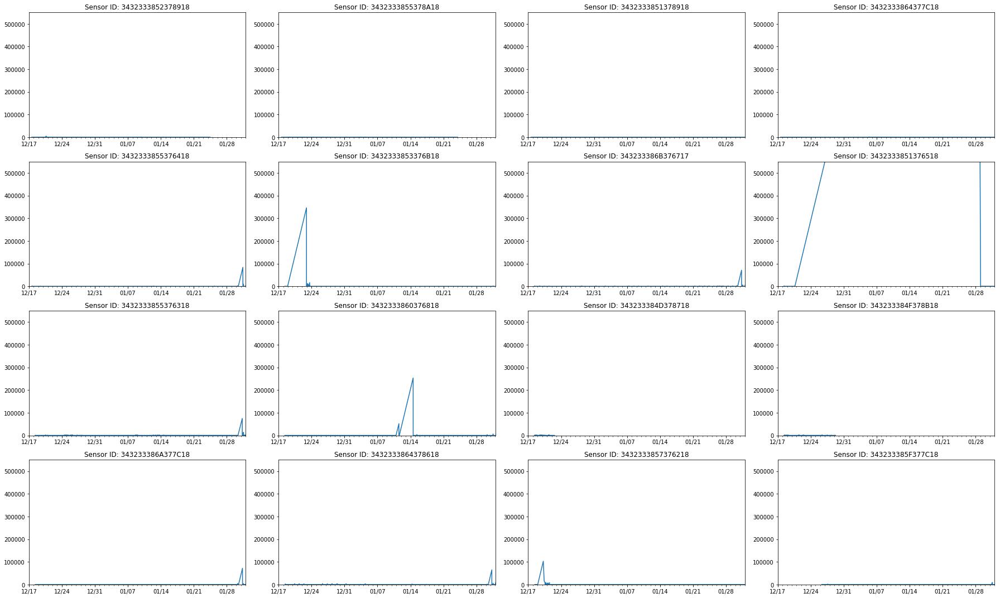

In [21]:
import datetime

categories = df_['device'].unique()
# z = working_days[(working_days['working day'] == 1)]
fig = plt.figure(figsize=(25,15))

mondays = mdates.WeekdayLocator(mdates.MONDAY)        # major ticks on the mondays
alldays = mdates.DayLocator()
weeksFmt = mdates.DateFormatter('%m/%d')

for c,num in zip(categories, range(1,len(categories)+1)):
    df0=all_data[all_data['device']==c]
    ax = fig.add_subplot(4, 4, num)
    ax.plot(df0['rx_time'], df0[['IPT']])
    ax.set_title("Sensor ID: " + str(c))
    ax.set_xlim([datetime.date(2018, 12, 17), datetime.date(2019, 2, 1)])
    ax.set_ylim(0,550000)

    ax.xaxis.set_major_locator(mondays)
    ax.xaxis.set_minor_locator(alldays)
    ax.xaxis.set_major_formatter(weeksFmt)
    
    # Plot working days
    #for xc in z.date.values:
    #    plt.axvline(x=xc, color='r', linestyle='-')

plt.tight_layout()
# plt.savefig(r'C:\Users\JeffG\Dropbox\ICT-Elektronica\Thesis\scripts\Case 2 - Bel-Air\Results' + '/metadata_IPT_time.png')
# plt.savefig(r'C:\Users\Jeff\Dropbox\ICT-Elektronica\Thesis\scripts\Case 2 - Bel-Air\Results' + '/metadata_IPT_time_merged.png')
plt.show()

In [22]:
IPT_30_filt = all_data[all_data['IPT']<30]

In [23]:
IPT_30_filt.groupby(['spfact'])['IPT'].describe(percentiles=[0.125,0.25,0.375,0.50,0.625,0.750,0.875,0.95])

,count,mean,std,min,12.5%,25%,37.5%,50%,62.5%,75%,87.5%,95%,max
spfact,,,,,,,,,,,,,
7.0,12902.0,20.138196,8.182178,0.0,8.0,14.0,20.0,23.0,26.0,27.0,27.0,28.0,29.0
8.0,13578.0,19.692002,8.200622,0.0,7.0,14.0,19.0,23.0,26.0,27.0,27.0,28.0,29.0
9.0,11918.0,19.811546,8.038157,0.0,8.0,15.0,19.0,23.0,26.0,27.0,27.0,28.0,29.0
10.0,11019.0,19.339595,8.487823,0.0,7.0,13.0,18.0,23.0,26.0,27.0,27.0,28.0,29.0
11.0,3734.0,20.266738,8.087228,0.0,8.0,14.0,20.0,24.0,26.0,27.0,27.0,28.0,29.0
12.0,2761.0,18.746469,8.464729,0.0,6.0,12.0,18.0,21.0,24.0,27.0,27.0,28.0,29.0


# Take one sensor and filter IPT <30

In [24]:
thingID = '3432333864377C18'
thing_data = all_data[all_data['device']==thingID].reset_index(drop=True)
thing_data.head()

,device,gpsLat,gpsLon,rx_time,seqNumber,spfact,IPT
0,3432333864377C18,51.215332,4.408462,2018-12-17 14:16:01.122,8826.0,7.0,94.0
1,3432333864377C18,51.215347,4.408432,2018-12-17 14:16:32.466,8827.0,7.0,31.0
2,3432333864377C18,51.215347,4.408414,2018-12-17 14:17:04.410,8828.0,8.0,31.0
3,3432333864377C18,51.215347,4.408394,2018-12-17 14:17:35.768,8829.0,8.0,31.0
4,3432333864377C18,51.215363,4.408419,2018-12-17 14:18:39.055,8831.0,8.0,63.0


In [25]:
IPT_30_filt = thing_data[thing_data['IPT']<30]
IPT_30_filt.head()

,device,gpsLat,gpsLon,rx_time,seqNumber,spfact,IPT
629,3432333864377C18,NaN,NaN,2018-12-17 21:15:52.542,NaN,7.0,27.0
634,3432333864377C18,NaN,NaN,2018-12-17 21:20:17.949,NaN,7.0,28.0
636,3432333864377C18,NaN,NaN,2018-12-17 21:21:23.311,NaN,7.0,26.0
639,3432333864377C18,NaN,NaN,2018-12-17 21:23:47.633,NaN,7.0,10.0
640,3432333864377C18,NaN,NaN,2018-12-17 21:24:15.438,NaN,7.0,27.0


In [26]:
IPT_30_filt_prev = thing_data.iloc[IPT_30_filt.index.values-1]
IPT_30_filt_prev_cur = IPT_30_filt.append(IPT_30_filt_prev).sort_values('rx_time').drop_duplicates()

In [27]:
IPT_30_filt_prev_cur.to_csv(str(thingID) + '_IPT_under_30s.csv')

In [28]:
IPT_15_filt = thing_data[thing_data['IPT']<15]
IPT_15_filt_prev = thing_data.iloc[IPT_15_filt.index.values-1]
IPT_15_filt_prev_cur = IPT_15_filt.append(IPT_15_filt_prev).sort_values(['rx_time']).drop_duplicates()

In [29]:
IPT_15_filt_prev_cur.to_csv(str(thingID) + '_IPT_under_15s.csv')

In [30]:
import plotly.plotly as py
import plotly.graph_objs as go

import pandas as pd
from datetime import datetime

# Create a trace
trace = go.Scatter(
    x = IPT_15_filt_prev_cur['rx_time'],
    y = IPT_15_filt_prev_cur['IPT'],
    mode = 'markers'
)

data = [trace]

# Plot and embed in ipython notebook!
py.iplot(data, filename='basic-scatter')

C:\Users\Jeff\Anaconda3\lib\site-packages\IPython\core\display.py:689: UserWarning:

Consider using IPython.display.IFrame instead



In [31]:
IPT_15_filt_prev_cur

,device,gpsLat,gpsLon,rx_time,seqNumber,spfact,IPT
638,3432333864377C18,NaN,NaN,2018-12-17 21:23:36.977,NaN,7.0,66.0
639,3432333864377C18,NaN,NaN,2018-12-17 21:23:47.633,NaN,7.0,10.0
672,3432333864377C18,NaN,NaN,2018-12-17 21:42:32.573,NaN,7.0,39.0
673,3432333864377C18,NaN,NaN,2018-12-17 21:42:41.478,NaN,7.0,8.0
726,3432333864377C18,NaN,NaN,2018-12-17 22:16:19.169,NaN,7.0,30.0
727,3432333864377C18,NaN,NaN,2018-12-17 22:16:25.196,NaN,7.0,6.0
734,3432333864377C18,NaN,NaN,2018-12-17 22:20:55.711,NaN,7.0,37.0
735,3432333864377C18,NaN,NaN,2018-12-17 22:20:56.308,NaN,7.0,0.0
750,3432333864377C18,NaN,NaN,2018-12-17 22:29:51.617,NaN,7.0,32.0
751,3432333864377C18,NaN,NaN,2018-12-17 22:29:56.981,NaN,7.0,5.0


In [32]:
raw_data = pd.read_csv(r'D:\Documents\Thesis\Case 2 - data\data\lora.3432333864377C18'+'\\lora.'+str(thingID) +'_' + 'airquality.no2' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
raw_data['time'] = pd.to_datetime(raw_data['time'], unit='ms')

In [33]:
first_timestamp = datetime(2018,12,17,21,40,0)
last_timestamp = datetime(2018,12,17,21,45,0)

raw_data[(raw_data['time']>first_timestamp) & (raw_data['time']<last_timestamp)]

,time,value
2085,2018-12-17 21:40:20.894,68.033660
2086,2018-12-17 21:40:47.102,66.828550
2087,2018-12-17 21:41:26.254,57.910774
2088,2018-12-17 21:41:53.432,64.615540
2089,2018-12-17 21:42:32.573,57.647842
2090,2018-12-17 21:42:41.478,52.958890
2091,2018-12-17 21:43:13.020,51.162186
2092,2018-12-17 21:43:44.371,54.010616
2093,2018-12-17 21:44:16.286,56.990513
2094,2018-12-17 21:44:48.653,51.249832


# Check if PM1 is missing at high SPF

In [47]:
thingID = '3432333855378A18'

In [48]:
df_1 = df[df['device']== thingID]
first_timestamp = df_1.iloc[0].rx_time; #print(first_timestamp)
last_timestamp = df_1.iloc[-1].rx_time; #print(last_timestamp)

In [49]:
raw_data_no2 = pd.read_csv(r'D:\Documents\Thesis\Case 2 - data\data\lora.'+ str(thingID)+'\\lora.'+str(thingID) +'_' + 'airquality.no2' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
raw_data_no2['time'] = pd.to_datetime(raw_data_no2['time'], unit='ms')
raw_data_no2 = raw_data_no2[(raw_data_no2['time']>first_timestamp) & (raw_data_no2['time']<last_timestamp)]
raw_data_pm1 = pd.read_csv(r'D:\Documents\Thesis\Case 2 - data\data\lora.'+str(thingID)+'\\lora.'+str(thingID) +'_' + 'airquality.pm1' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
raw_data_pm1['time'] = pd.to_datetime(raw_data_pm1['time'], unit='ms')
raw_data_pm1 = raw_data_pm1[(raw_data_pm1['time']>first_timestamp) & (raw_data_pm1['time']<last_timestamp)]

In [60]:
print(len(raw_data_no2))
raw_data_no2.tail()

76655


,time,value
77889,2019-01-23 10:16:24.366,153.85905
77890,2019-01-23 10:19:01.877,167.13712
77891,2019-01-23 10:19:33.713,166.39214
77892,2019-01-23 10:20:05.123,148.75378
77893,2019-01-23 10:21:08.143,148.09645


In [59]:
print(len(raw_data_pm1))
raw_data_pm1.tail()

52630


,time,value
53628,2019-01-23 10:16:24.366,31.571684
53629,2019-01-23 10:19:01.877,31.384424
53630,2019-01-23 10:19:33.713,31.030354
53631,2019-01-23 10:20:05.123,31.030354
53632,2019-01-23 10:21:08.143,29.990183


In [58]:
common = raw_data_pm1.merge(raw_data_no2,on=['time','time'])
print(len(common))
common.head()

52630


,time,value_x,value_y
0,2018-12-17 14:14:19.768,6.310823,107.626840
1,2018-12-17 14:14:51.045,6.310823,108.656654
2,2018-12-17 14:15:22.881,4.399521,110.278070
3,2018-12-17 14:15:54.245,4.399521,112.775925
4,2018-12-17 14:17:29.969,5.068406,86.197876


In [53]:
missing_pm1 = raw_data_no2[(~raw_data_no2['time'].isin(common['time']))]
missing_pm1.head()

,time,value
1267,2018-12-17 14:33:16.103,99.38830
1268,2018-12-17 14:33:48.151,100.74678
1269,2018-12-17 14:34:27.300,98.46804
1270,2018-12-17 14:36:17.735,99.97990
1271,2018-12-17 14:38:46.079,99.05963


In [54]:
common_meta = missing_pm1.merge(df, left_on='time', right_on='rx_time', how='inner')

In [55]:
common_count = common_meta.groupby(['spfact']).count()
common_count

,time,value,device,gpsLat,gpsLon,rx_time,seqNumber
spfact,,,,,,,
7,5,5,5,5,5,5,5
8,8,8,8,8,8,8,8
9,39,39,39,39,39,39,39
10,676,676,676,676,676,676,676
11,366,366,366,366,366,366,366
12,112,112,112,112,112,112,112


In [56]:
count = common_meta.groupby(['spfact']).count()
print(count)
# n = ['id','code','month']
# mux = pd.MultiIndex.from_product([df.index.levels[0],df.index.levels[1], range(13)], names=n)
count = count.reindex(range(7,13), fill_value=0)
count

        time  value  device  gpsLat  gpsLon  rx_time  seqNumber
spfact                                                         
7          5      5       5       5       5        5          5
8          8      8       8       8       8        8          8
9         39     39      39      39      39       39         39
10       676    676     676     676     676      676        676
11       366    366     366     366     366      366        366
12       112    112     112     112     112      112        112


,time,value,device,gpsLat,gpsLon,rx_time,seqNumber
spfact,,,,,,,
7,5,5,5,5,5,5,5
8,8,8,8,8,8,8,8
9,39,39,39,39,39,39,39
10,676,676,676,676,676,676,676
11,366,366,366,366,366,366,366
12,112,112,112,112,112,112,112


In [45]:
PM1_SF_meta = pd.DataFrame(columns=['device', 'Missing PM1', 'Matches in meta','Matches %', 'SF7', 'SF8', 'SF9', 'SF10', 'SF11', 'SF12'])
for thingID in device_ids:
    df_1 = df[df['device']== thingID]
    first_timestamp = df_1.iloc[0].rx_time; #print(first_timestamp)
    last_timestamp = df_1.iloc[-1].rx_time; #print(last_timestamp)
    raw_data_no2 = pd.read_csv(r'D:\Documents\Thesis\Case 2 - data\data\lora.' + str(thingID) +'\\lora.'+str(thingID) +'_' + 'airquality.no2' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
    raw_data_no2['time'] = pd.to_datetime(raw_data_no2['time'], unit='ms')
    raw_data_no2 = raw_data_no2[(raw_data_no2['time']>first_timestamp) & (raw_data_no2['time']<last_timestamp)]
    raw_data_pm1 = pd.read_csv(r'D:\Documents\Thesis\Case 2 - data\data\lora.' + str(thingID) +'\\lora.'+str(thingID) +'_' + 'airquality.pm1' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
    raw_data_pm1['time'] = pd.to_datetime(raw_data_pm1['time'], unit='ms')
    raw_data_pm1 = raw_data_pm1[(raw_data_pm1['time']>first_timestamp) & (raw_data_pm1['time']<last_timestamp)]
    common = raw_data_pm1.merge(raw_data_no2,on=['time','time'])
    missing_pm1 = raw_data_no2[(~raw_data_no2['time'].isin(common['time']))]
    common_meta = missing_pm1.merge(df, left_on='time', right_on='rx_time', how='inner')
    common_count = common_meta.groupby(['spfact']).count()
    common_count = common_count.reindex(range(7,13), fill_value=0)
    PM1_SF_meta = PM1_SF_meta.append({'device': thingID,
                            'Missing PM1': len(missing_pm1),
                            'Matches in meta': len(common_meta),
                            'Matches %': len(common_meta)/len(missing_pm1)*100,
                            'SF7': common_count.iloc[0][0], 
                            'SF8': common_count.iloc[1][0], 
                            'SF9': common_count.iloc[2][0], 
                            'SF10': common_count.iloc[3][0], 
                            'SF11': common_count.iloc[4][0], 
                            'SF12': common_count.iloc[5][0]}, ignore_index=True)

PM1_SF_meta

,device,Missing PM1,Matches in meta,Matches %,SF7,SF8,SF9,SF10,SF11,SF12
0,3432333852378918,371,315,84.905660,0,2,8,181,92,32
1,3432333864377C18,2678,671,25.056012,2,3,11,498,97,60
2,3432333851378918,1131,608,53.757737,1,4,17,396,152,38
3,3432333855378A18,24025,1206,5.019771,5,8,39,676,366,112
4,3432333855376418,6276,2223,35.420650,1,5,60,1300,713,144
5,343233386B376717,21142,3231,15.282376,2,6,47,1236,1008,932
6,343233386A377C18,1076,960,89.219331,0,3,25,708,208,16
7,3432333853376B18,245,153,62.448980,0,0,7,114,31,1
8,343233384F378B18,9238,947,10.251137,4,3,25,332,318,265
9,3432333860376818,150,107,71.333333,0,0,2,90,15,0


In [46]:
PM1_SF_all = pd.DataFrame(columns=['device', 'Missing PM1', 'Matches in all_data','Matches %', 'SF7', 'SF8', 'SF9', 'SF10', 'SF11', 'SF12'])
for thingID in device_ids:
    df_1 = df[df['device']== thingID]
    first_timestamp = df_1.iloc[0].rx_time; #print(first_timestamp)
    last_timestamp = df_1.iloc[-1].rx_time; #print(last_timestamp)
    raw_data_no2 = pd.read_csv(r'D:\Documents\Thesis\Case 2 - data\data\lora.' + str(thingID) +'\\lora.'+str(thingID) +'_' + 'airquality.no2' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
    raw_data_no2['time'] = pd.to_datetime(raw_data_no2['time'], unit='ms')
    raw_data_no2 = raw_data_no2[(raw_data_no2['time']>first_timestamp) & (raw_data_no2['time']<last_timestamp)]
    raw_data_pm1 = pd.read_csv(r'D:\Documents\Thesis\Case 2 - data\data\lora.' + str(thingID) +'\\lora.'+str(thingID) +'_' + 'airquality.pm1' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
    raw_data_pm1['time'] = pd.to_datetime(raw_data_pm1['time'], unit='ms')
    raw_data_pm1 = raw_data_pm1[(raw_data_pm1['time']>first_timestamp) & (raw_data_pm1['time']<last_timestamp)]
    common = raw_data_pm1.merge(raw_data_no2,on=['time','time'])
    missing_pm1 = raw_data_no2[(~raw_data_no2['time'].isin(common['time']))]
    common_all = missing_pm1.merge(all_data, left_on='time', right_on='rx_time', how='inner')
    common_count = common_all.groupby(['spfact']).count()
    common_count = common_count.reindex(range(7,13), fill_value=0)
    PM1_SF_all = PM1_SF_all.append({'device': thingID,
                            'Missing PM1': len(missing_pm1),
                            'Matches in all_data': len(common_all),
                            'Matches %': len(common_all)/len(missing_pm1)*100,
                            'SF7': common_count.iloc[0][0], 
                            'SF8': common_count.iloc[1][0], 
                            'SF9': common_count.iloc[2][0], 
                            'SF10': common_count.iloc[3][0], 
                            'SF11': common_count.iloc[4][0], 
                            'SF12': common_count.iloc[5][0]}, ignore_index=True)

PM1_SF_all

,device,Missing PM1,Matches in all_data,Matches %,SF7,SF8,SF9,SF10,SF11,SF12
0,3432333852378918,371,349,94.070081,57,2,8,159,91,32
1,3432333864377C18,2678,2446,91.336819,1823,178,20,334,77,14
2,3432333851378918,1131,794,70.203360,387,122,23,192,50,20
3,3432333855378A18,24025,23546,98.006243,7683,11088,3141,1342,224,68
4,3432333855376418,6276,6277,100.015934,2288,1470,355,1304,716,144
5,343233386B376717,21142,20707,97.942484,6166,4234,2557,2033,1800,3917
6,343233386A377C18,1076,872,81.040892,71,3,51,567,167,13
7,3432333853376B18,245,177,72.244898,25,48,4,64,18,18
8,343233384F378B18,9238,9241,100.032475,725,3115,2912,1358,866,265
9,3432333860376818,150,112,74.666667,14,8,11,72,7,0


## Plot NO2 vs PM1 to check missing data periods

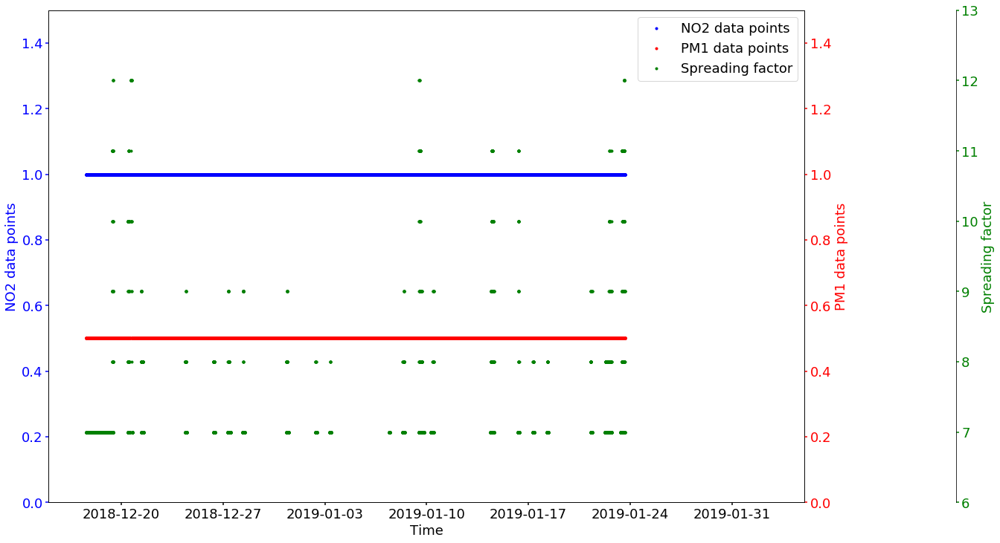

<Figure size 1080x720 with 0 Axes>

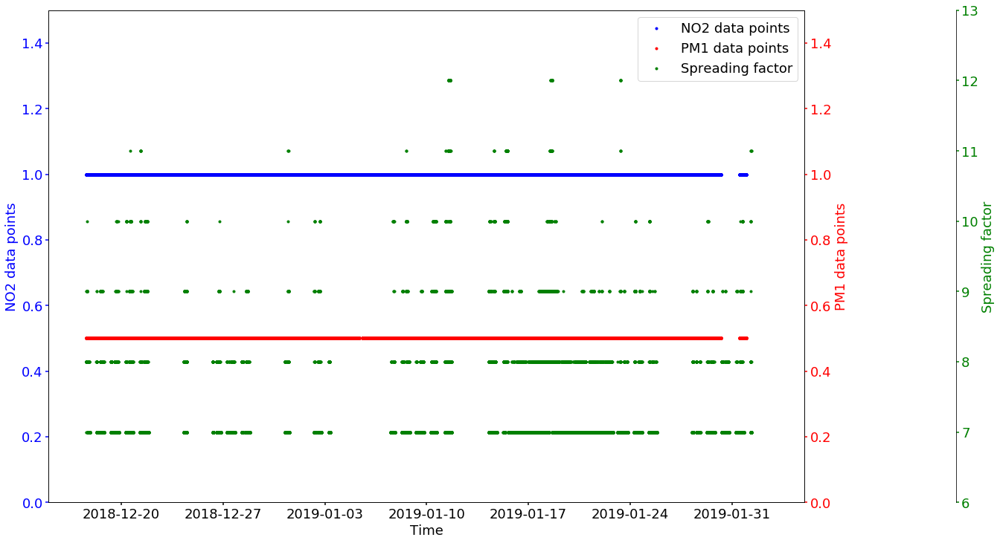

<Figure size 1080x720 with 0 Axes>

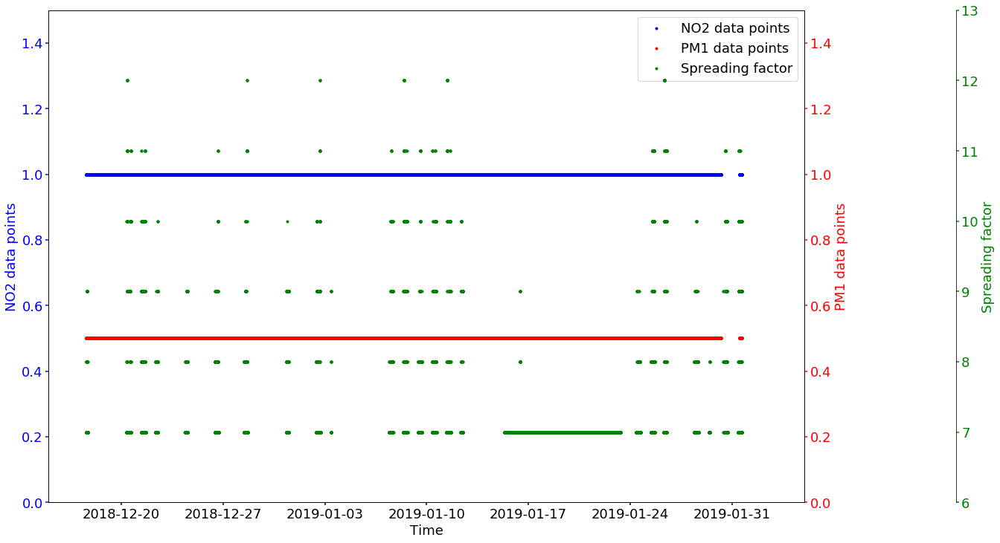

<Figure size 1080x720 with 0 Axes>

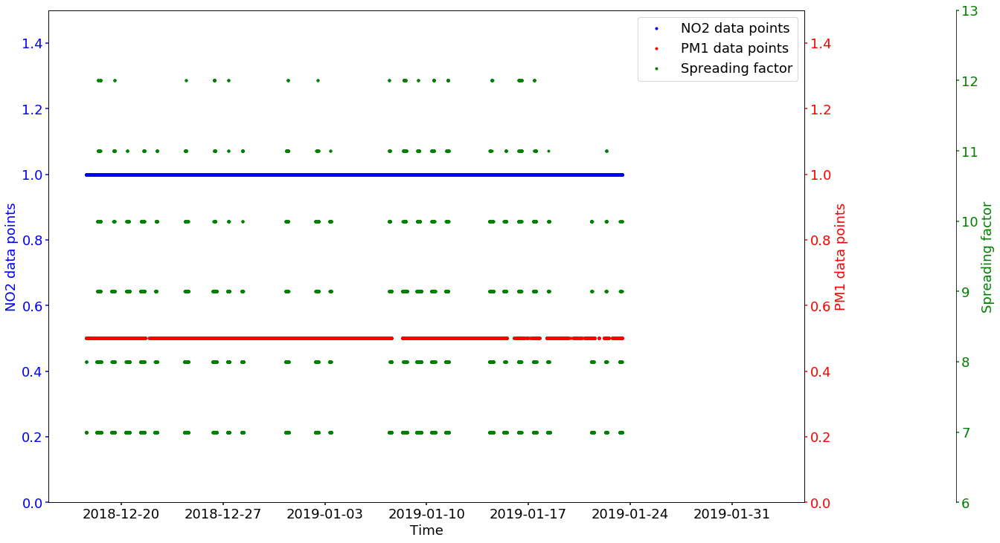

<Figure size 1080x720 with 0 Axes>

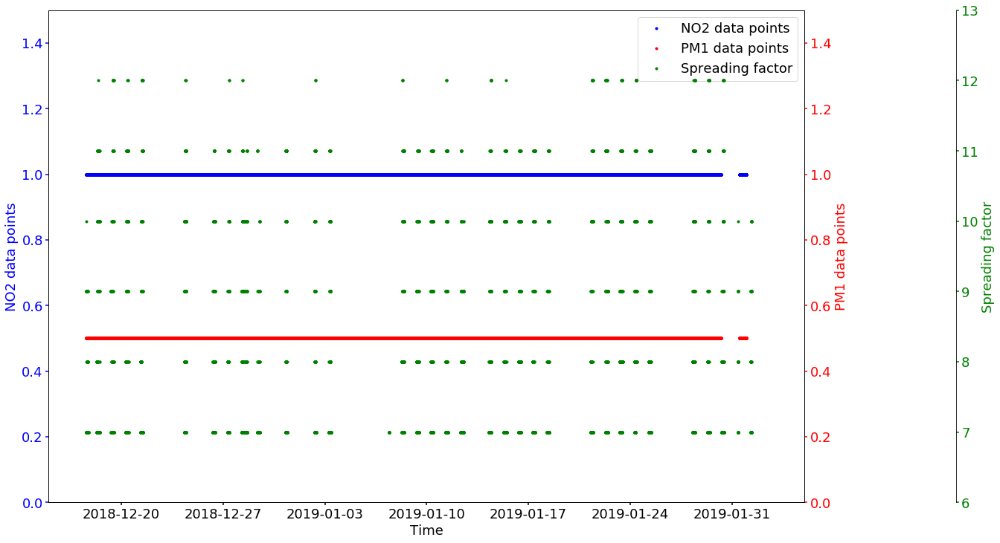

<Figure size 1080x720 with 0 Axes>

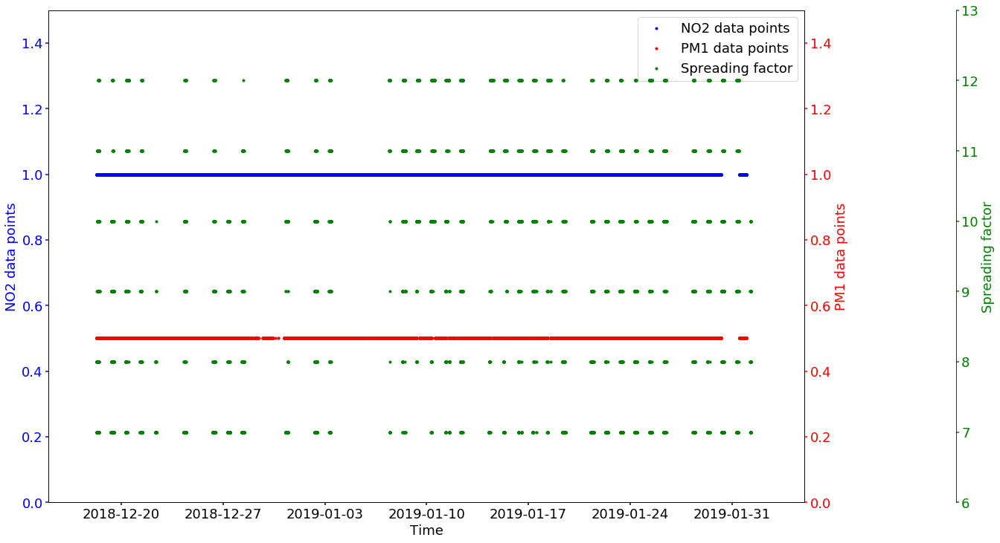

<Figure size 1080x720 with 0 Axes>

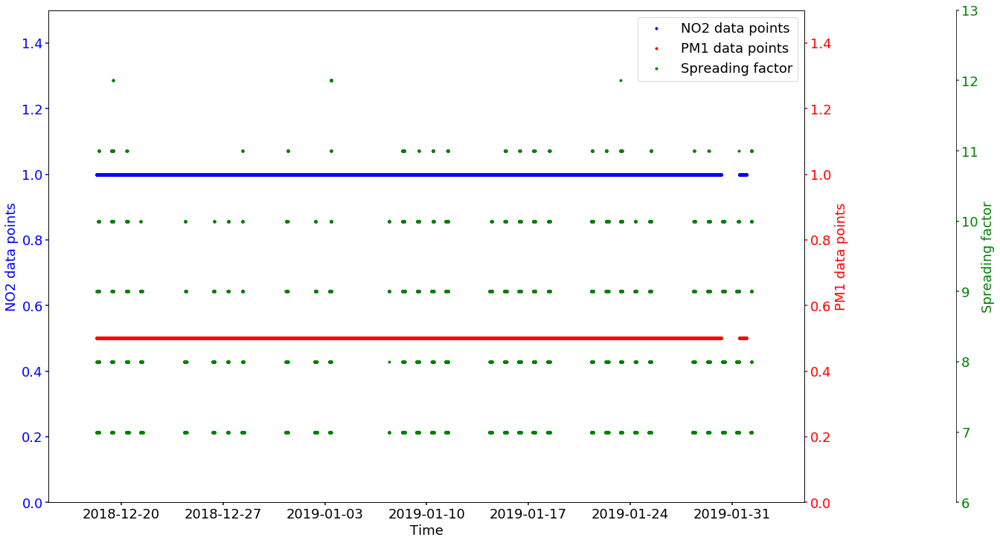

<Figure size 1080x720 with 0 Axes>

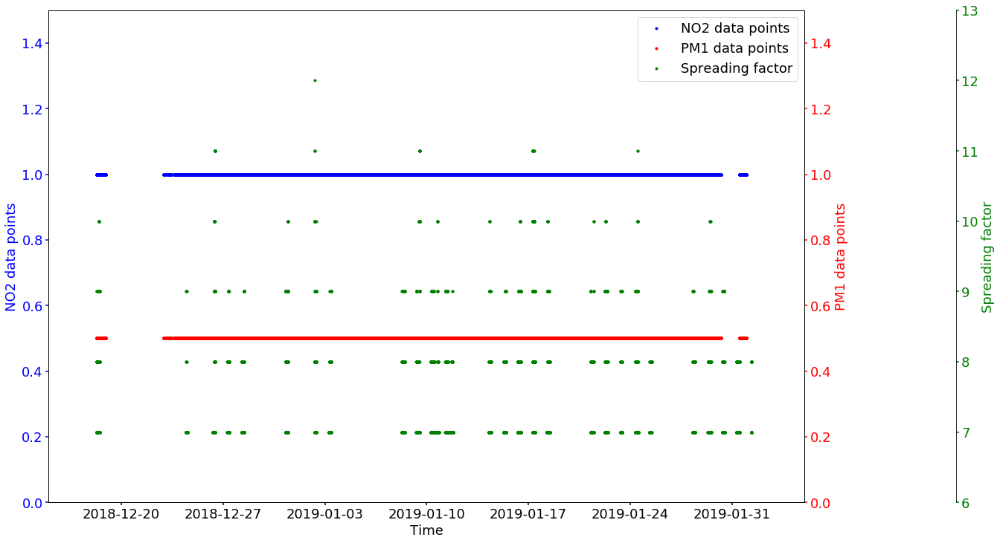

<Figure size 1080x720 with 0 Axes>

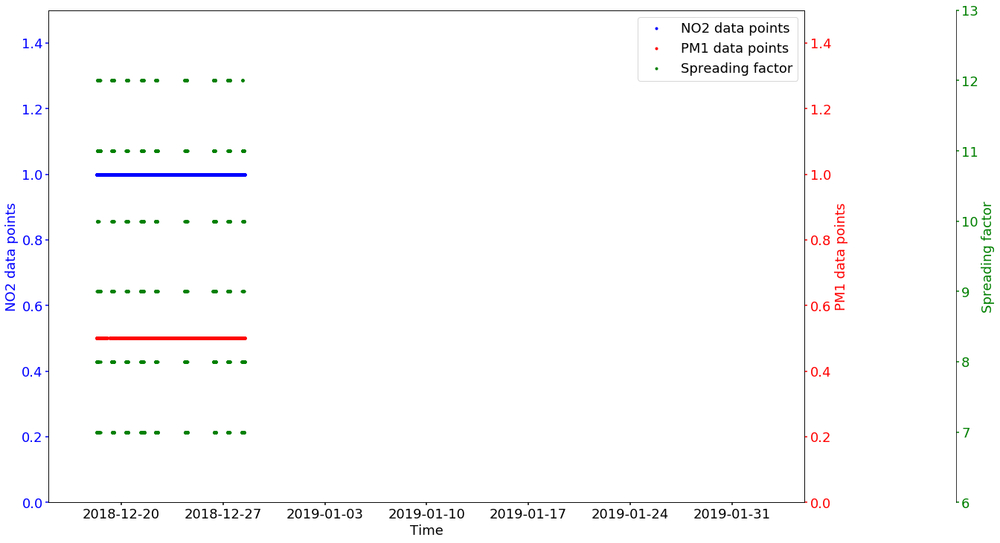

<Figure size 1080x720 with 0 Axes>

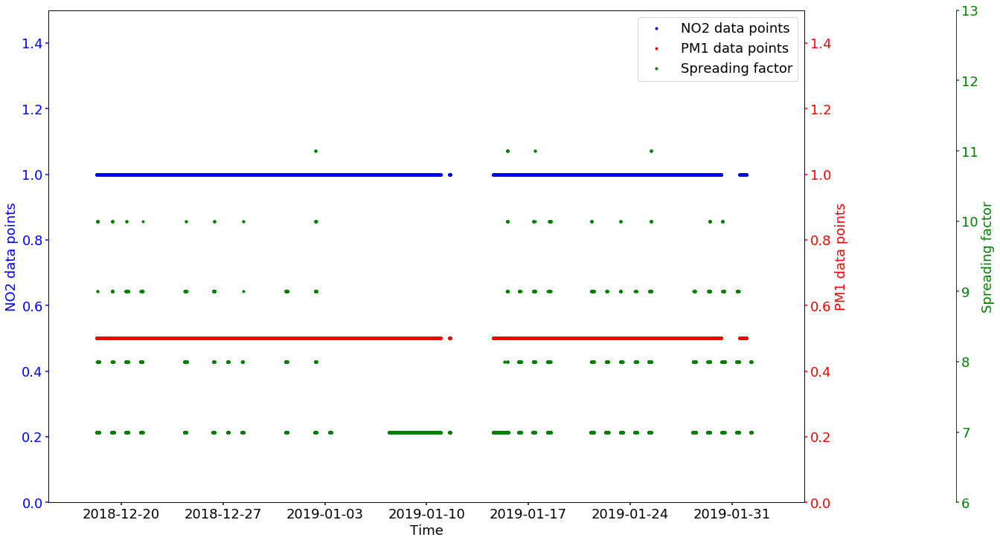

<Figure size 1080x720 with 0 Axes>

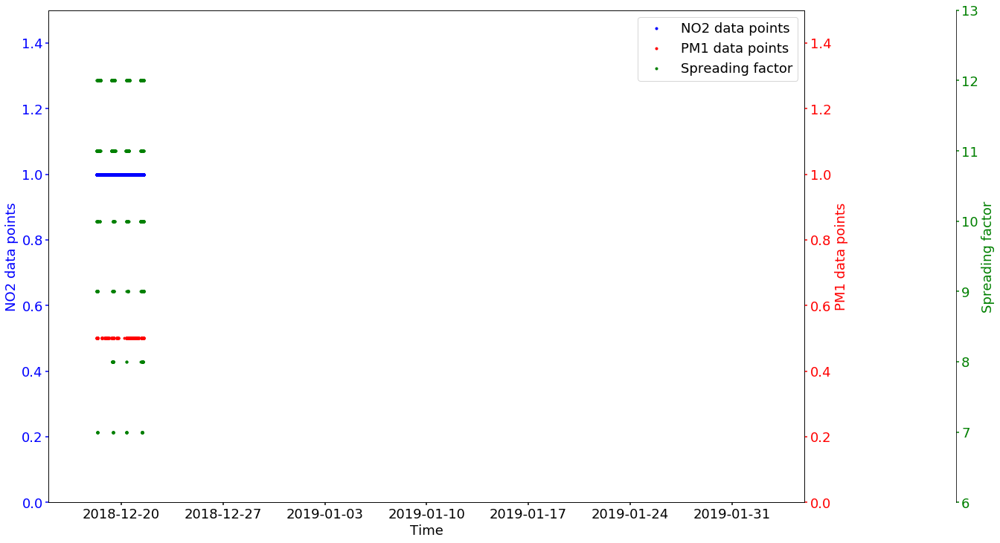

<Figure size 1080x720 with 0 Axes>

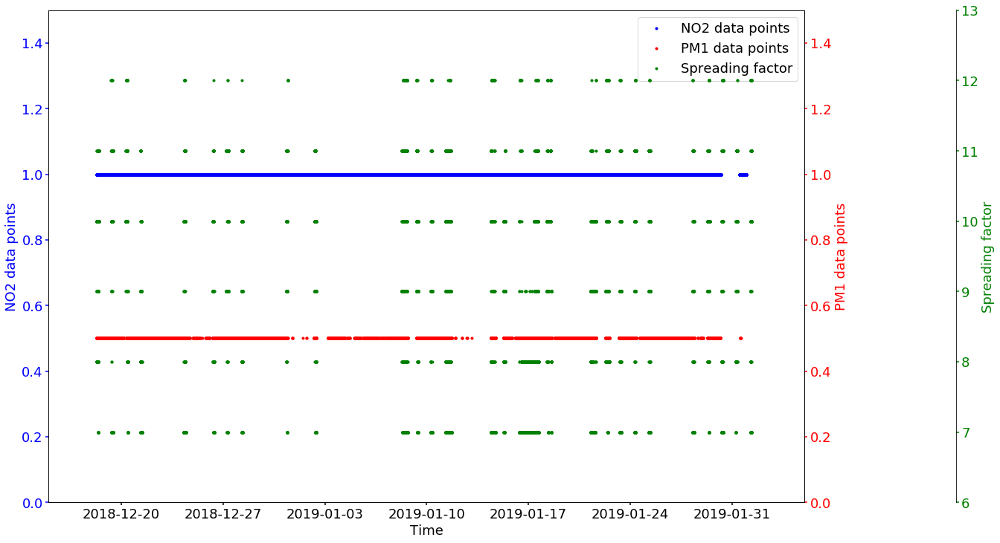

<Figure size 1080x720 with 0 Axes>

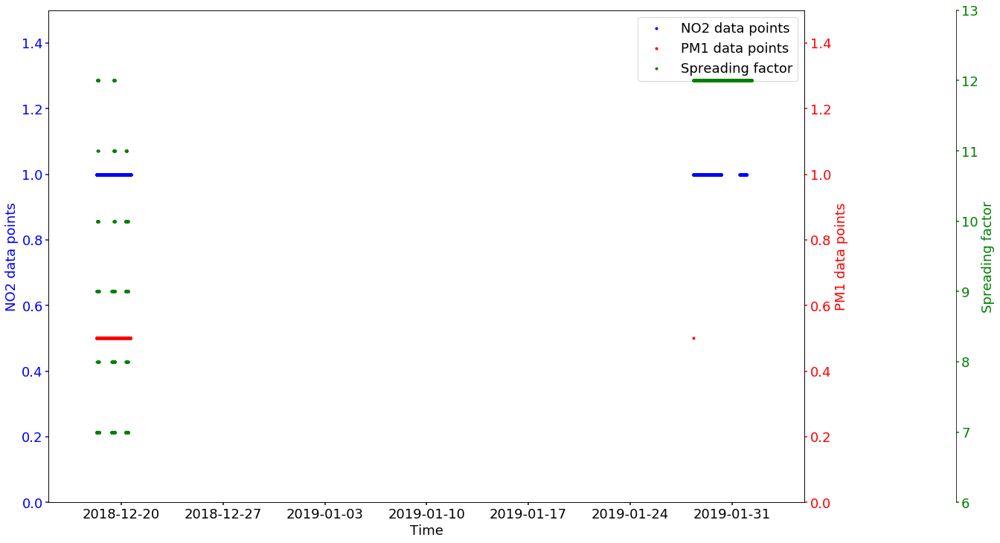

<Figure size 1080x720 with 0 Axes>

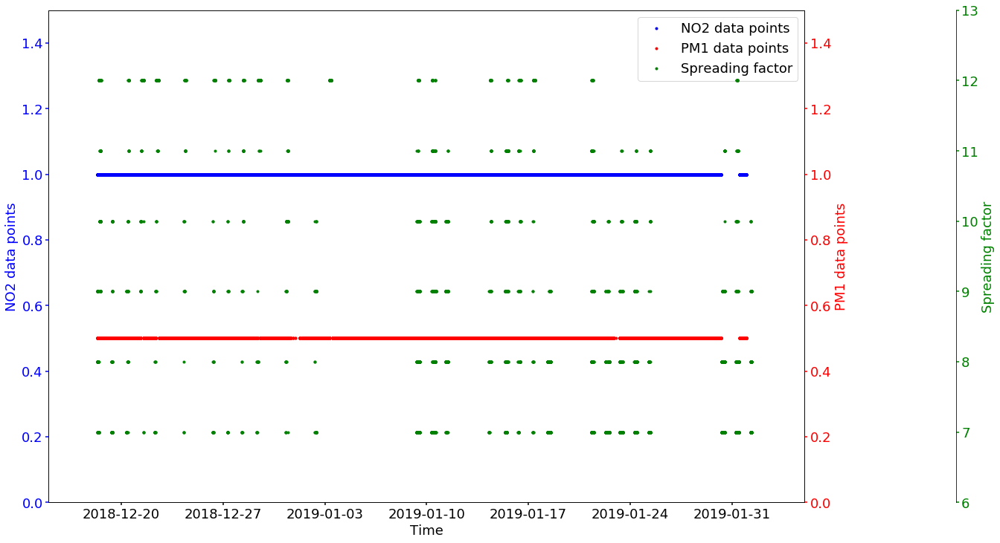

<Figure size 1080x720 with 0 Axes>

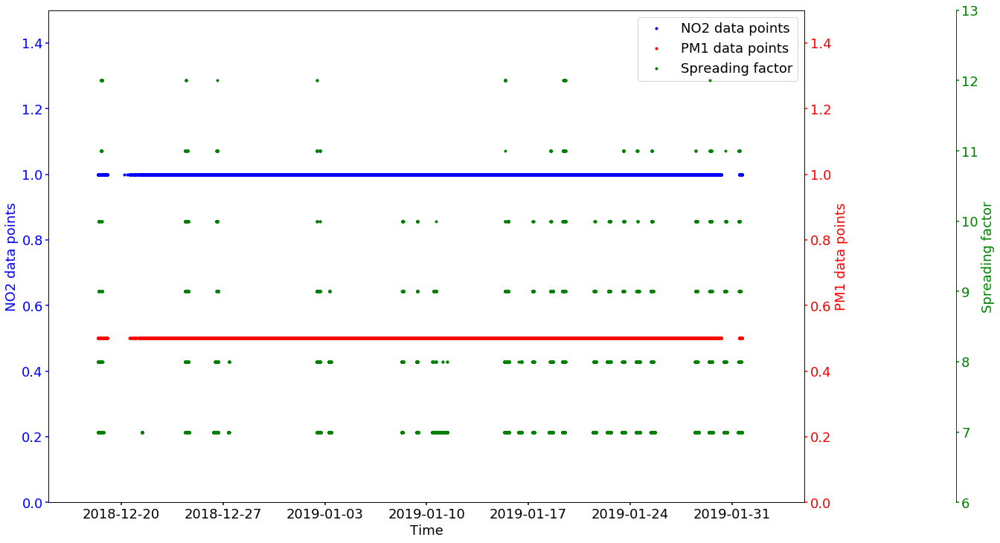

<Figure size 1080x720 with 0 Axes>

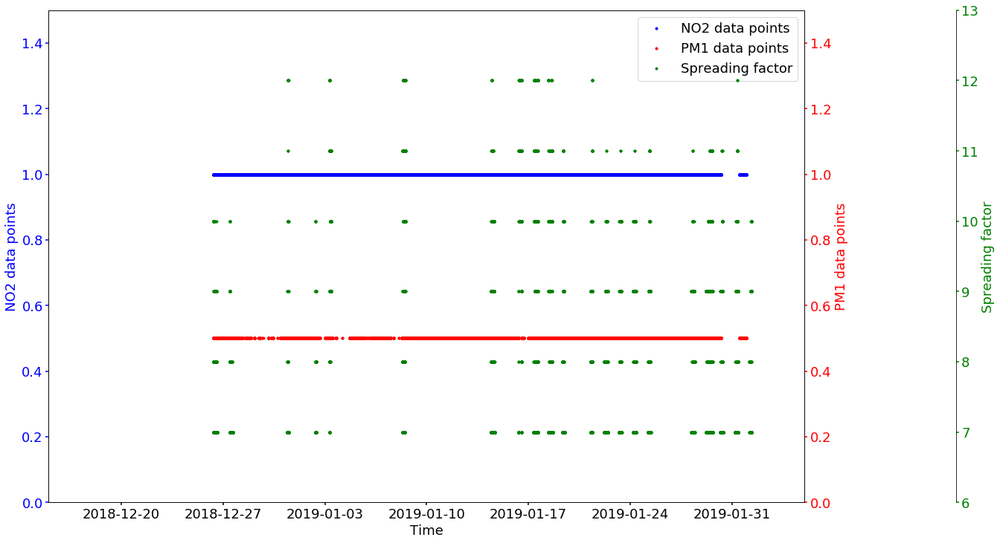

<Figure size 1080x720 with 0 Axes>

In [73]:
def make_patch_spines_invisible(ax):
    ax.set_frame_on(True)
    ax.patch.set_visible(False)
    for sp in ax.spines.values():
        sp.set_visible(False)

for thingID in device_ids:
    df_1 = df[df['device']== thingID]
    first_timestamp = df_1.iloc[0].rx_time; #print(first_timestamp)
    last_timestamp = df_1.iloc[-1].rx_time; #print(last_timestamp)
    raw_data_no2 = pd.read_csv(r'D:\Documents\Thesis\Case 2 - data\data\lora.'+ str(thingID)+'\\lora.'+str(thingID) +'_' + 'airquality.no2' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
    raw_data_no2['time'] = pd.to_datetime(raw_data_no2['time'], unit='ms')
    raw_data_no2 = raw_data_no2[(raw_data_no2['time']>first_timestamp) & (raw_data_no2['time']<last_timestamp)]
    raw_data_pm1 = pd.read_csv(r'D:\Documents\Thesis\Case 2 - data\data\lora.'+str(thingID)+'\\lora.'+str(thingID) +'_' + 'airquality.pm1' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
    raw_data_pm1['time'] = pd.to_datetime(raw_data_pm1['time'], unit='ms')
    raw_data_pm1 = raw_data_pm1[(raw_data_pm1['time']>first_timestamp) & (raw_data_pm1['time']<last_timestamp)]
    
    fig, host = plt.subplots()
    fig.subplots_adjust(right=0.75)
    plt.figure(figsize=(15,10))
    
    par1 = host.twinx()
    par2 = host.twinx()
    
    # Offset the right spine of par2.  The ticks and label have already been
    # placed on the right by twinx above.
    par2.spines["right"].set_position(("axes", 1.2))
    # Having been created by twinx, par2 has its frame off, so the line of its
    # detached spine is invisible.  First, activate the frame but make the patch
    # and spines invisible.
    make_patch_spines_invisible(par2)
    # Second, show the right spine.
    par2.spines["right"].set_visible(True)
    
    x1=raw_data_no2.time
    y1=np.ones(len(raw_data_no2))
    
    x2=raw_data_pm1.time
    y2=np.ones(len(raw_data_pm1))/2
    
    x3=df_1['rx_time']
    y3=df_1['spfact']
    
    p1, = host.plot(x1, y1, "b.", label="NO2 data points")
    p2, = par1.plot(x2, y2, "r.", label="PM1 data points")
    p3, = par2.plot(x3, y3, "g.", label="Spreading factor")
    
    host.set_xlim(left=datetime(2018,12,15), right=datetime(2019,2,5))
    host.set_ylim(0, 1.5)
    par1.set_ylim(0, 1.5)
    par2.set_ylim(6, 13)

    host.set_xlabel("Time")
    host.set_ylabel("NO2 data points")
    par1.set_ylabel("PM1 data points")
    par2.set_ylabel("Spreading factor")

    host.yaxis.label.set_color(p1.get_color())
    par1.yaxis.label.set_color(p2.get_color())
    par2.yaxis.label.set_color(p3.get_color())

    tkw = dict(size=4, width=1.5)
    host.tick_params(axis='y', colors=p1.get_color(), **tkw)
    par1.tick_params(axis='y', colors=p2.get_color(), **tkw)
    par2.tick_params(axis='y', colors=p3.get_color(), **tkw)
    host.tick_params(axis='x', **tkw)

    lines = [p1, p2, p3]

    host.legend(lines, [l.get_label() for l in lines])

#     x1=raw_data_no2.time
#     y1=np.ones(len(raw_data_no2))
#     ax1.plot(x1, y1, 'b.')
#     ax1.set_xlabel('time (s)')
#     ax1.set_xlim(left=datetime(2018,12,15), right=datetime(2019,2,5))
#     # Make the y-axis label, ticks and tick labels match the line color.
#     ax1.set_ylabel('NO2 data points', color='b')
#     ax1.tick_params('y', colors='b')
#     ax1.set_ylim([0,1.5])

#     ax2 = ax1.twinx()
#     x2=raw_data_pm1.time
#     y2=np.ones(len(raw_data_pm1))/2
#     ax2.plot(x2, y2, 'r.')
#     ax2.set_ylabel('PM1 data points', color='r')
#     ax2.tick_params('y', colors='r')
    
    

    plt.rcParams.update({'font.size': 18})
    fig.set_size_inches(18.5, 10.5)

    fig.tight_layout()
    fig.savefig(r'C:\Users\Jeff\Dropbox\ICT-Elektronica\Thesis\scripts\Case 2 - Bel-Air\Results' + '/PM1_NO2_test_' + thingID + '.png', bbox_inches="tight")
#     plt.show()

## Plot missing PM1 locations

In [74]:
thingID = '3432333855378A18'

In [85]:
all_missing_pm1 = pd.DataFrame(columns=['time', 'value', 'device', 'gpsLat', 'gpsLon', 'rx_time', 'seqNumber','spfact'])
for thingID in device_ids:
    df_1 = df[df['device']== thingID]
    first_timestamp = df_1.iloc[0].rx_time; #print(first_timestamp)
    last_timestamp = df_1.iloc[-1].rx_time; #print(last_timestamp)
    raw_data_no2 = pd.read_csv(r'D:\Documents\Thesis\Case 2 - data\data\lora.'+ str(thingID)+'\\lora.'+str(thingID) +'_' + 'airquality.no2' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
    raw_data_no2['time'] = pd.to_datetime(raw_data_no2['time'], unit='ms')
    raw_data_no2 = raw_data_no2[(raw_data_no2['time']>first_timestamp) & (raw_data_no2['time']<last_timestamp)]
    raw_data_pm1 = pd.read_csv(r'D:\Documents\Thesis\Case 2 - data\data\lora.'+str(thingID)+'\\lora.'+str(thingID) +'_' + 'airquality.pm1' +'_Belair'+'.csv').drop(columns=['Unnamed: 0'])
    raw_data_pm1['time'] = pd.to_datetime(raw_data_pm1['time'], unit='ms')
    raw_data_pm1 = raw_data_pm1[(raw_data_pm1['time']>first_timestamp) & (raw_data_pm1['time']<last_timestamp)]
    common = raw_data_pm1.merge(raw_data_no2,on=['time','time'])
    missing_pm1 = raw_data_no2[(~raw_data_no2['time'].isin(common['time']))]
    missing_pm1_meta = missing_pm1.merge(df_1, left_on='time', right_on='rx_time', how='inner')
    
    all_missing_pm1 = all_missing_pm1.append(missing_pm1_meta, ignore_index=True)

all_missing_pm1 = all_missing_pm1.reset_index(drop=True)
all_missing_pm1.head()

,time,value,device,gpsLat,gpsLon,rx_time,seqNumber,spfact
0,2018-12-19 09:32:57.666,91.522250,3432333852378918,51.224052,4.436692,2018-12-19 09:32:57.666,59857,11
1,2018-12-19 09:33:28.539,114.835556,3432333852378918,51.223999,4.436703,2018-12-19 09:33:28.539,59858,11
2,2018-12-19 09:35:25.130,121.321210,3432333852378918,51.221451,4.436684,2018-12-19 09:35:25.130,59859,11
3,2018-12-19 09:35:57.004,113.038860,3432333852378918,51.221165,4.436560,2018-12-19 09:35:57.004,59860,11
4,2018-12-19 09:37:53.640,107.122890,3432333852378918,51.219887,4.435606,2018-12-19 09:37:53.640,59861,11


In [86]:
len(all_missing_pm1)

17841

In [100]:
def color_producer(spf):
    if spf == 7:
        return 'darkgreen'
    elif spf == 8:
        return 'green'
    elif spf == 9:
        return 'yellow'
    elif spf == 10:
        return 'orange'
    elif spf == 11:
        return 'red'
    elif spf == 12:
        return 'darkred'
    else:
        return 'black'
    
def scatter_plot_spf(df, filename):
    mp = folium.Map(location=[df['gpsLat'].mean(), df['gpsLon'].mean()], 
                    zoom_start=13)

    # Generate legend
    legend_html = '''
         <div style="position: fixed; 
                     bottom: 50px; left: 50px; width: 100px; height: 150px; 
                     border:2px solid grey; z-index:9999; font-size:14px; background-color:white;
                     ">&nbsp; <b> Legend </b> <br>
                     &nbsp; SPF 7 &nbsp; <i class="fa fa-circle" style="color:darkgreen"></i><br>
                     &nbsp; SPF 8 &nbsp; <i class="fa fa-circle" style="color:green"></i><br>
                     &nbsp; SPF 9 &nbsp; <i class="fa fa-circle" style="color:yellow"></i><br>
                     &nbsp; SPF 10 &nbsp; <i class="fa fa-circle" style="color:orange"></i><br>
                     &nbsp; SPF 11 &nbsp; <i class="fa fa-circle" style="color:red"></i><br>
                     &nbsp; SPF 12 &nbsp; <i class="fa fa-circle" style="color:darkred"></i>
          </div>
         '''
    # Add legend to map
    mp.get_root().html.add_child(folium.Element(legend_html))
    
    # Extract latitude, longitude and spreading factor
    lat = list(df["gpsLat"])
    lon = list(df["gpsLon"])
    spf = list(df["spfact"])
    time = list(df["rx_time"])
    device = list(df["device"])

    fg = folium.FeatureGroup(name="Scatter plot Spreading Factor")
    
    # Add circles for every data point
    for lt, ln, sp, ti, dev in zip(lat, lon, spf, time, device):
        cim = folium.CircleMarker(location=[lt, ln],
                                radius = 6,
                                popup="SPF: " + str(sp) + "\n timestamp: " + str(ti) + "\n device: " + str(dev),
                                fill=True, # Set fill to True
                                fill_color=color_producer(sp),
                                color = color_producer(sp),
                                fill_opacity=0.7)
        fg.add_child(cim)

    # Show the map
    mp.add_child(fg)
    
     # Save the map
    mp.save(r'C:\Users\Jeff\Dropbox\ICT-Elektronica\Thesis\scripts\Case 2 - Bel-Air\Results' + '/' + filename + '.html')
    
    return mp 

In [97]:
scatter_plot_spf(all_missing_pm1, 'all_missing_pm1')

In [107]:
all_missing_pm1_low_sf = all_missing_pm1[all_missing_pm1['spfact']<9]
print(len(all_missing_pm1_low_sf))

63


In [104]:
scatter_plot_spf(all_missing_pm1_low_sf, 'missing_pm1_low_sf')

# Anomaly detection

## Static threshold

In [112]:
all_data_stats = all_data.groupby(['spfact'])['IPT'].describe(percentiles=[0.25,0.50,0.75,0.85,0.90,0.95,0.99,0.995])
all_data_stats

,count,mean,std,min,25%,50%,75%,85%,90%,95%,99%,99.5%,max
spfact,,,,,,,,,,,,,
7.0,674925.0,37.630485,552.648888,0.0,31.0,31.0,31.0,32.0,63.0,63.0,95.0,126.0,346163.0
8.0,241793.0,38.299008,30.450178,0.0,31.0,31.0,32.0,62.0,63.0,66.0,133.0,149.0,5967.0
9.0,120422.0,40.330770,252.347209,0.0,31.0,31.0,38.0,63.0,63.0,70.0,139.0,149.0,83730.0
10.0,79525.0,44.410424,444.061727,0.0,31.0,31.0,43.0,63.0,66.0,94.0,148.0,149.0,74900.0
11.0,41373.0,45.725932,37.184311,0.0,31.0,31.0,44.0,63.0,77.0,122.0,212.0,262.0,930.0
12.0,22642.0,204.483791,22233.664791,0.0,31.0,31.0,62.0,70.0,117.0,191.0,265.0,398.0,3345596.0


In [115]:
all_data_stats.iloc[0][12]

346163.0

In [116]:
all_data_filtered = all_data[((all_data['spfact']==7) & (all_data['IPT']<all_data_stats.iloc[0][11])) |
                             ((all_data['spfact']==8) & (all_data['IPT']<all_data_stats.iloc[1][11]))|
                             ((all_data['spfact']==9) & (all_data['IPT']<all_data_stats.iloc[2][11]))|
                             ((all_data['spfact']==10) & (all_data['IPT']<all_data_stats.iloc[3][11]))|
                             ((all_data['spfact']==11) & (all_data['IPT']<all_data_stats.iloc[4][11]))|
                             ((all_data['spfact']==12) & (all_data['IPT']<all_data_stats.iloc[5][11]))]

In [117]:
filtered_stats = all_data_filtered.groupby(['spfact'])['IPT'].describe(percentiles=[0.25,0.50,0.75,0.85,0.90,0.95,0.99,0.995])
filtered_stats

,count,mean,std,min,25%,50%,75%,85%,90%,95%,99%,99.5%,max
spfact,,,,,,,,,,,,,
7.0,671289.0,35.312278,12.669636,0.0,31.0,31.0,31.0,32.0,63.0,63.0,94.0,95.0,125.0
8.0,240427.0,37.321948,17.565805,0.0,31.0,31.0,32.0,59.0,63.0,64.0,118.0,130.0,148.0
9.0,119735.0,38.403767,19.537174,0.0,31.0,31.0,37.0,63.0,63.0,67.0,126.0,135.0,148.0
10.0,78972.0,40.200577,22.868213,0.0,31.0,31.0,41.0,63.0,65.0,93.0,136.0,148.0,148.0
11.0,41159.0,44.379455,31.684928,0.0,31.0,31.0,42.0,63.0,70.0,121.0,155.0,209.0,260.0
12.0,22527.0,53.711768,53.355672,0.0,31.0,31.0,62.0,69.0,111.0,171.0,264.0,265.0,397.0


In [119]:
mean_7 = filtered_stats.iloc[0][1]
std_7 = filtered_stats.iloc[0][2]
mean_8 = filtered_stats.iloc[1][1]
std_8 = filtered_stats.iloc[1][2]
mean_9 = filtered_stats.iloc[2][1]
std_9 = filtered_stats.iloc[2][2]
mean_10 = filtered_stats.iloc[3][1]
std_10 = filtered_stats.iloc[3][2]
mean_11 = filtered_stats.iloc[4][1]
std_11 = filtered_stats.iloc[4][2]
mean_12 = filtered_stats.iloc[5][1]
std_12 = filtered_stats.iloc[5][2]

In [120]:
anomalies = all_data[((all_data['spfact']==7) & (all_data['IPT']>mean_7+3*std_7)) |
                             ((all_data['spfact']==8) & (all_data['IPT']>mean_8+3*std_8))|
                             ((all_data['spfact']==9) & (all_data['IPT']>mean_9+3*std_9))|
                             ((all_data['spfact']==10) & (all_data['IPT']>mean_10+3*std_10))|
                             ((all_data['spfact']==11) & (all_data['IPT']>mean_11+3*std_11))|
                             ((all_data['spfact']==12) & (all_data['IPT']>mean_11+3*std_12))]

In [121]:
anomalies.groupby(['spfact'])['IPT'].describe(percentiles=[0.25,0.50,0.75,0.85,0.90,0.95,0.99,0.995])

,count,mean,std,min,25%,50%,75%,85%,90%,95%,99%,99.5%,max
spfact,,,,,,,,,,,,,
7.0,14245.0,190.407933,3800.419649,74.0,94.0,95.0,126.0,127.0,148.0,158.00,347.00,820.02,346163.0
8.0,8657.0,125.503754,119.454625,91.0,94.0,110.0,139.0,149.0,155.0,213.00,265.00,281.00,5967.0
9.0,3263.0,176.910818,1524.355312,98.0,115.0,126.0,148.0,150.0,171.0,243.00,283.00,393.80,83730.0
10.0,2847.0,229.844398,2338.069347,109.0,121.0,133.0,148.0,149.0,169.0,226.70,280.54,348.77,74900.0
11.0,1550.0,185.093548,64.727314,140.0,148.0,149.0,220.0,258.0,264.0,296.55,446.51,507.57,930.0
12.0,1093.0,3359.591949,101187.113800,205.0,249.0,264.0,265.0,281.0,408.4,529.00,1060.44,1536.84,3345596.0


In [122]:
len(anomalies)

31655

In [123]:
len(anomalies)/len(all_data)

0.026810820882881052

## Unsupervised learning - DBSCAN

### Import libraries

In [44]:
import numpy as np

from sklearn.cluster import DBSCAN
from sklearn import metrics
from sklearn.datasets.samples_generator import make_blobs
from sklearn.preprocessing import StandardScaler

### Select data

In [50]:
# Select features
df_ftrs = all_data[['spfact', 'IPT']]
X = all_data[['spfact', 'IPT']]

# Normalize interpacket times
X['IPT']=df_ftrs.groupby('spfact').transform(lambda x: (x - x.min()) / (x.max()-x.min()))

# Take 10k samples since more is difficult to calculate the DBSCAN
Xnew = X.values
X = X.sample(10000).values


labels_true = X[:,0]

C:\Users\Jeff\Anaconda3\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


### Define DBSCAN

In [52]:
def perform_dbscan(X, n_eps, n_min_samples):
    # Compute DBSCAN
    db = DBSCAN(eps=n_eps, min_samples=n_min_samples).fit(X)
    core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
    core_samples_mask[db.core_sample_indices_] = True
    labels = db.labels_

    # Number of clusters in labels, ignoring noise if present.
    n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
    n_noise_ = list(labels).count(-1)

    print('Estimated number of clusters: %d' % n_clusters_)
    print('Estimated number of noise points: %d' % n_noise_)
#     print("Homogeneity: %0.3f" % metrics.homogeneity_score(labels_true, labels))
#     print("Completeness: %0.3f" % metrics.completeness_score(labels_true, labels))
#     print("V-measure: %0.3f" % metrics.v_measure_score(labels_true, labels))
#     print("Adjusted Rand Index: %0.3f"
#           % metrics.adjusted_rand_score(labels_true, labels))
#     print("Adjusted Mutual Information: %0.3f"
#           % metrics.adjusted_mutual_info_score(labels_true, labels))
#     print("Silhouette Coefficient: %0.3f"
#           % metrics.silhouette_score(X, labels))
    
    return db, core_samples_mask, n_clusters_, n_noise_

### Define plotting function

In [57]:
def plot_dbscan(X, labels, core_samples_mask, title, n_eps, n_min_smaples):
    # Plot result
    # Black removed and is used for noise instead.
    unique_labels = set(labels)
    colors = [plt.cm.Spectral(each)
              for each in np.linspace(0, 1, len(unique_labels))]
    for k, col in zip(unique_labels, colors):
        if k == -1:
            # Black used for noise.
            col = [0, 0, 0, 1]

        class_member_mask = (labels == k)

        xy = X[class_member_mask & core_samples_mask]
        plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
                 markeredgecolor='k', markersize=14)

        xy = X[class_member_mask & ~core_samples_mask]
        plt.plot(xy[:, 0], xy[:, 1], 'o', markerfacecolor=tuple(col),
                 markeredgecolor='k', markersize=6)

    plt.title(title)
    plt.tight_layout()
    plt.savefig(r'C:\Users\Jeff\Dropbox\ICT-Elektronica\Thesis\scripts\Case 2 - Bel-Air\Results\DBSCAN_2D' + '/DBSCAN_2D_{}_{}.png'.format(n_eps, n_min_samples), dpi=(200), bbox_inches="tight")
    plt.show()

### Run different configurations to find the right parameters

Estimated number of clusters: 8
Estimated number of noise points: 70


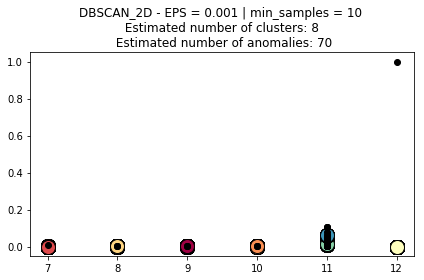

Estimated number of clusters: 7
Estimated number of noise points: 122


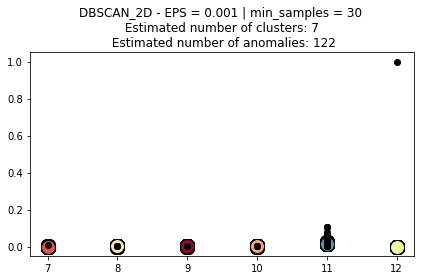

Estimated number of clusters: 6
Estimated number of noise points: 179


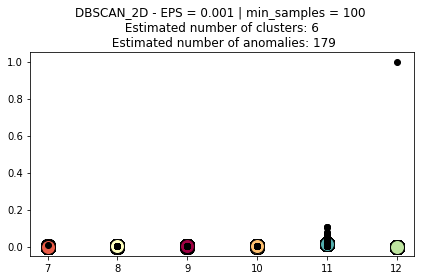

Estimated number of clusters: 4
Estimated number of noise points: 608


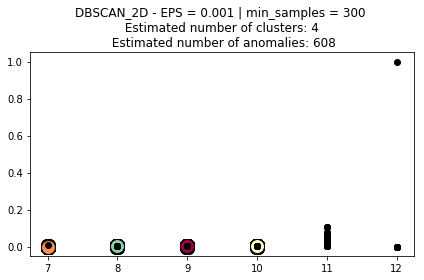

Estimated number of clusters: 9
Estimated number of noise points: 19


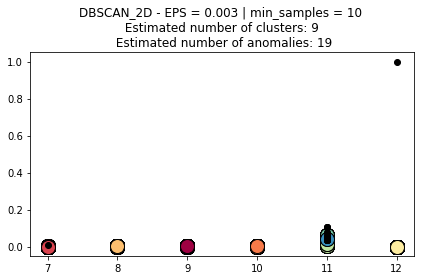

Estimated number of clusters: 7
Estimated number of noise points: 64


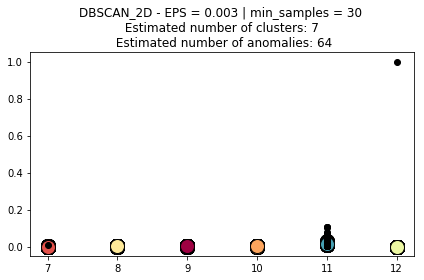

Estimated number of clusters: 6
Estimated number of noise points: 121


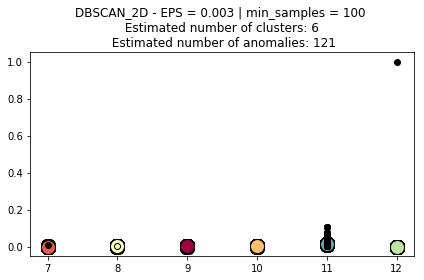

Estimated number of clusters: 4
Estimated number of noise points: 599


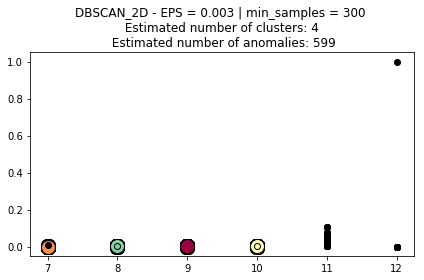

Estimated number of clusters: 6
Estimated number of noise points: 5


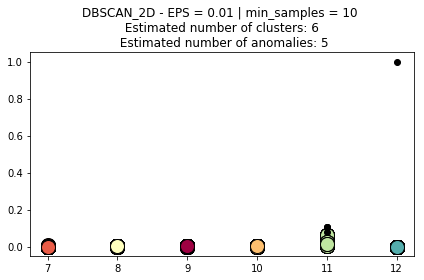

Estimated number of clusters: 7
Estimated number of noise points: 6


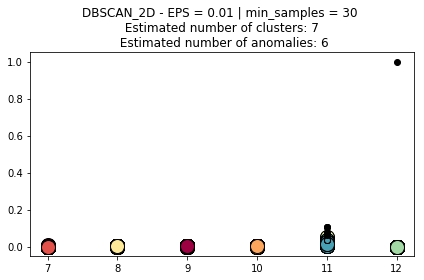

Estimated number of clusters: 6
Estimated number of noise points: 49


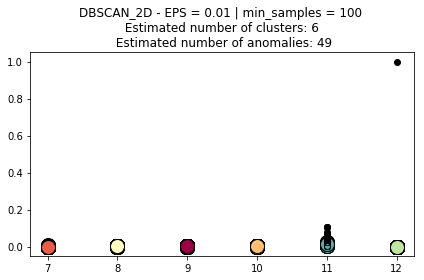

Estimated number of clusters: 5
Estimated number of noise points: 279


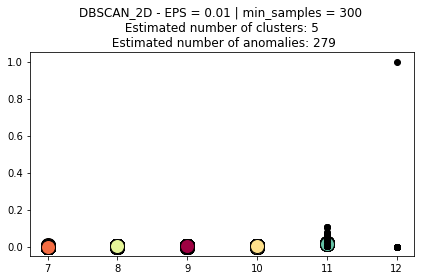

Estimated number of clusters: 6
Estimated number of noise points: 1


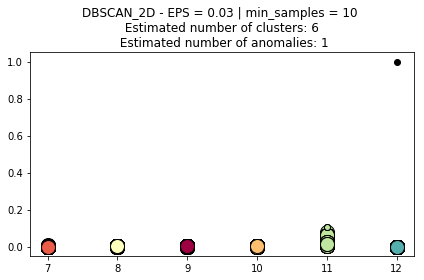

Estimated number of clusters: 6
Estimated number of noise points: 4


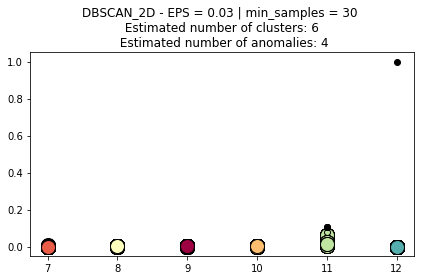

Estimated number of clusters: 6
Estimated number of noise points: 4


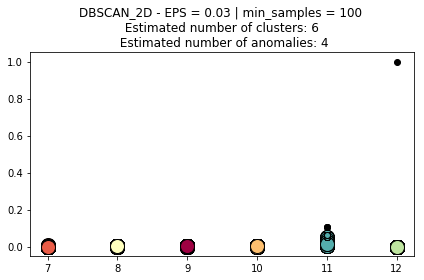

Estimated number of clusters: 5
Estimated number of noise points: 222


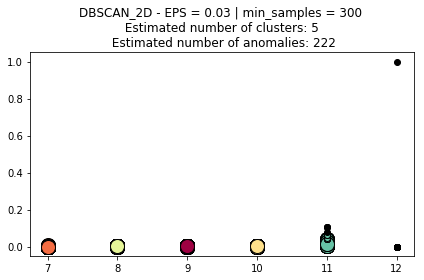

Estimated number of clusters: 6
Estimated number of noise points: 1


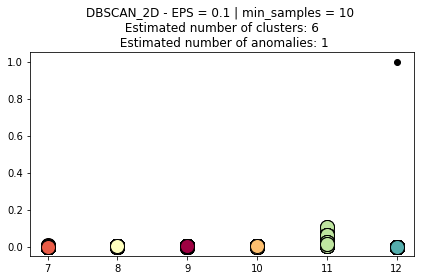

Estimated number of clusters: 6
Estimated number of noise points: 1


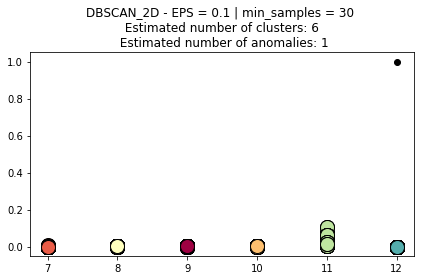

Estimated number of clusters: 6
Estimated number of noise points: 1


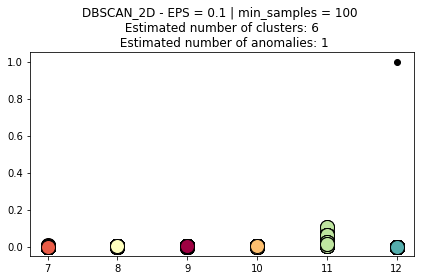

Estimated number of clusters: 5
Estimated number of noise points: 218


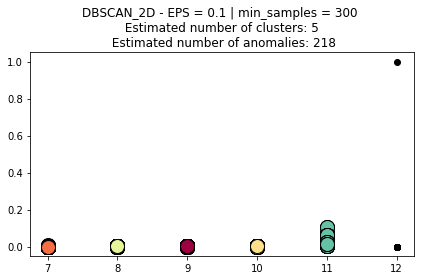

Estimated number of clusters: 6
Estimated number of noise points: 1


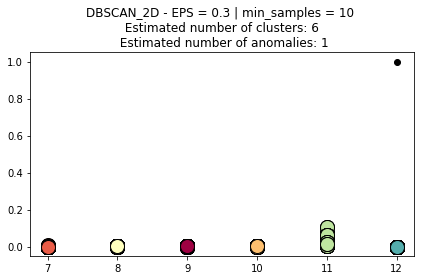

Estimated number of clusters: 6
Estimated number of noise points: 1


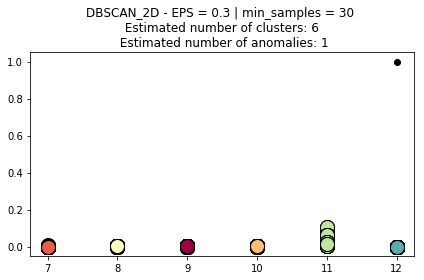

Estimated number of clusters: 6
Estimated number of noise points: 1


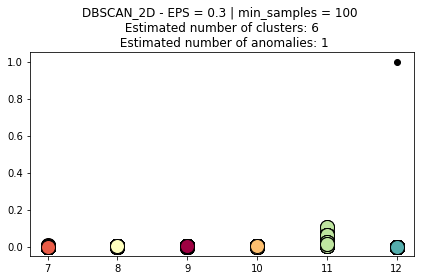

Estimated number of clusters: 5
Estimated number of noise points: 218


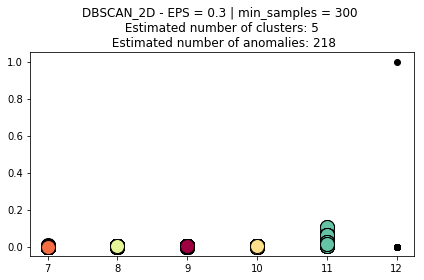

In [58]:
eps_ar = [0.001, 0.003, 0.01, 0.03, 0.1, 0.3]
min_samples_ar = [10, 30, 100, 300]

# eps_ar = [0.03]
# min_samples_ar = [30]

result = pd.DataFrame(columns=['EPS', 'min_samples', 'Nr of clusters', 'Nr of anomalies'])

for n_eps in eps_ar:
    for n_min_samples in min_samples_ar:
        # Run DBSCAN
        db, core_samples_mask, n_clusters_, n_noise_ = perform_dbscan(X, n_eps, n_min_samples)
        
        # Plot and save result
        title = 'DBSCAN_2D - EPS = {} | min_samples = {} \n Estimated number of clusters: {} \n Estimated number of anomalies: {}'.format(n_eps ,n_min_samples, n_clusters_, n_noise_)
        plot_dbscan(X, db.labels_, core_samples_mask, title, n_eps, n_min_samples)
        
        result = result.append({'EPS': n_eps, 
                                'min_samples':n_min_samples, 
                                'Nr of clusters': n_clusters_, 
                                'Nr of anomalies': n_noise_}, ignore_index=True)

In [54]:
result

,EPS,min_samples,Nr of clusters,Nr of anomalies
0,0.001,10.0,8.0,70.0
1,0.001,30.0,7.0,122.0
2,0.001,100.0,6.0,179.0
3,0.001,300.0,4.0,608.0
4,0.003,10.0,9.0,19.0
5,0.003,30.0,7.0,64.0
6,0.003,100.0,6.0,121.0
7,0.003,300.0,4.0,599.0
8,0.010,10.0,6.0,5.0
9,0.010,30.0,7.0,6.0


### Final choice

In [59]:
# Final choice for 2D case:
# EPS = 0.01
# min_samples = 100

db, core_samples_mask, n_clusters_, n_noise_ = perform_dbscan(X, 0.01, 100)

Estimated number of clusters: 6
Estimated number of noise points: 49


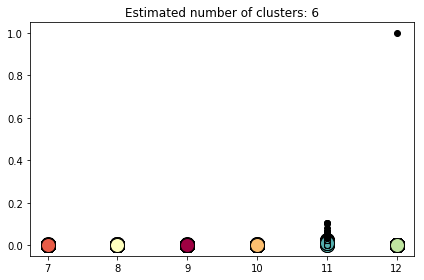

In [60]:
plot_dbscan(X, db.labels_, core_samples_mask, 'Estimated number of clusters: {}'.format(n_clusters_), 0.03, 30)

### Predict clusters on whole dataset

In [61]:
def dbscan_predict(model, X):

    nr_samples = X.shape[0]

    y_new = np.ones(shape=nr_samples, dtype=int) * -1

    for i in range(nr_samples):
        diff = model.components_ - X[i, :]  # NumPy broadcasting

        dist = np.linalg.norm(diff, axis=1)  # Euclidean distance

        shortest_dist_idx = np.argmin(dist)

        if dist[shortest_dist_idx] < model.eps:
            y_new[i] = model.labels_[model.core_sample_indices_[shortest_dist_idx]]

    return y_new

In [62]:
prediction_labels = dbscan_predict(db,Xnew)
prediction_indices = np.where(prediction_labels!=-1)
nr_anomalies_ = sum(prediction_labels==-1)
prediction_mask = np.zeros_like(prediction_labels, dtype=bool)
prediction_mask[prediction_indices] = True

In [63]:
print(nr_anomalies_)

4800


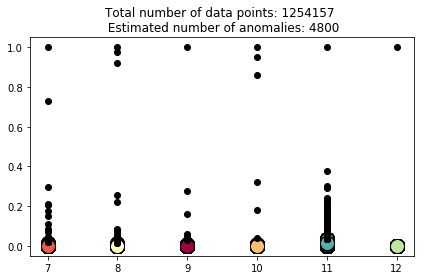

In [64]:
plot_dbscan(Xnew, prediction_labels, prediction_mask, 'Total number of data points: {} \n Estimated number of anomalies: {}'.format(len(prediction_labels), nr_anomalies_), 0.03, 30)